<a href="https://colab.research.google.com/github/mathllorente/dados/blob/main/Matheus_Leite_Llorente.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Quem sou eu?**

<a href="https://gifyu.com/image/Zx1p"><img src="https://s4.gifyu.com/images/Powtoon_GIF-1.gif" alt="Powtoon_GIF-1.gif" border="0" /></a>

Olá! este é o meu projeto final do **BootCamp DataScience Aplicada da Alura**. 

> Me chamo Matheus Leite Llorente, tenho 18 anos e sou discente de Ciências Atuariais pela Universidade Federal de São Paulo.

> Estudo Ciência de Dados desde meus 16 anos. 

> Todo feedback sobre o projeto é bem-vindo :)

> Me conheça através do **Linkedin**: https://www.linkedin.com/in/matheus-llorente/ 

> Outros projetos: https://linktr.ee/matheusllorente



---



# **Contexto**

A Covid-19, doença causada pelo coronavírus denominado SARS-CoV-2, foi identificada pela primeira vez na China, em dezembro de 2019. Em 30 de janeiro de 2020, a Organização Mundial da Saúde (OMS) declarou que a epidemia da COVID-19 constituía uma Emergência de Saúde Pública de Importância Internacional (ESPII), e, em 11 de março de 2020, uma pandemia.

O primeiro caso de Covid-19 no Brasil foi confirmado em 26 de fevereiro de 2020.  Com o crescimento do número de casos da Covid-19 e a ocorrência de transmissão comunitária, estratégias de mitigação passaram a ser adotadas, buscando-se evitar a ocorrência de casos graves e óbitos pela doença.

De modo geral, há urgência na obtenção de dados precisos para melhor prever e preparar os sistemas de saúde e evitar colapsos, definido pela necessidade de leitos de UTI acima da capacidade (assumindo que recursos humanos, EPIs e profissionais estejam disponíveis), usando dados clínicos individuais - em vez de dados epidemiológicos e populacionais . (informação extraída do Kaggle).

Foi proposta a tarefa
> Prever a admissão na UTI de casos confirmados de COVID-19.

A UTI deve ser considerada, como primeira versão desse conjunto de dados, a variável de destino, isto é, ICU como a label. 

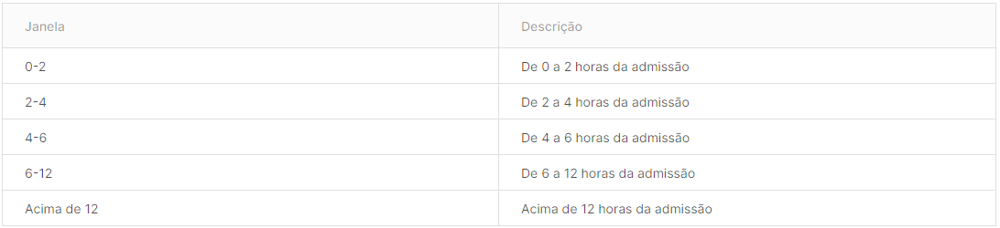

Este conjunto de dados contém dados anônimos do Hospital Sírio-Libanês, de São Paulo e de Brasília. Todos os dados foram tornados anônimos seguindo as melhores práticas e recomendações internacionais.
Os dados foram limpos e escalados por coluna de acordo com Min Max Scaler para caber entre -1 e 1.


# **Introdução**

O presente trabalho visa entender o comportamento de algumas variáveis em pacientes com COVID-19 e a necessidade de leitos de UTI para os mesmos. Os dados disponibilizados pelo Sírio-Libanês ofecerem uma gama gigantesca de informações, anonimizadas, à respeito de medidas em exames médicos a fim de uma possível avaliação do comportamento.

> De modo geral, as **U**nidades de **T**erapia **I**ntensiva foram desenvolvidas do início do século XX e modificaram a forma de tratar pacientes com doenças graves, principalmente em cenários de alto risco de morte. São ambientes de muita tecnologia e profissionais especializados. Com o passar dos anos, novos equipamentos e técnicas têm sido desenvolvidas, tornando-se uma área da medicina extremamente especializada.

Um dos pontos primordiais deste contexto é que, durante a pandemia, a **necessidade por leitos de UTI cresceu de forma exborbitante**, proporcional ao aumento de casos, levando a lotações e esgotamento dos recursos, principalmente dos respiradores mecânicos. 

> Objetiva-se, portanto, como visto na seção anterior, encontrar um ambiente e um modelo baseado em métricas de machine learning que seja capaz de utilizar da predição como fator de determinação da necessidade desses leitos, através do conjunto de dados disponibilizados. Diante disso, após toda a análise, visa promover pesquisas na entidade acadêmica, como também no próprio Sírio-Libanês.

<a href="https://gifyu.com/image/Zx1Q"><img src="https://s4.gifyu.com/images/Powtoon_GIF-2.gif" alt="Powtoon_GIF-2.gif" border="0" /></a>

**Índice**

De uma maneira fácil você pode acessar o sumário do trabalho. Veja como: 

<a href="https://gifyu.com/image/ZK1I"><img src="https://s4.gifyu.com/images/final_603476a7357559004d2ced89_67827.gif" alt="final_603476a7357559004d2ced89_67827.gif" border="0" width = "300" /></a>

**Cronologia do notebook**

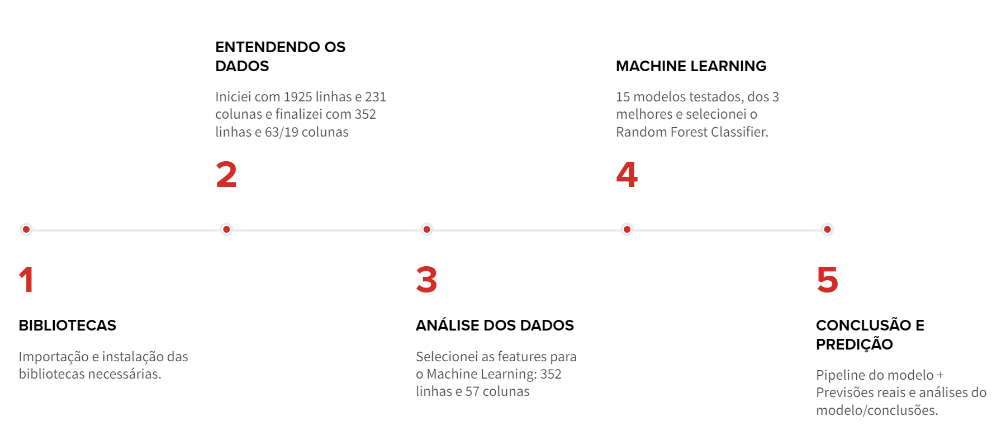



# **1. Bibliotecas utilizadas**

## **Instalação de bibliotecas e como instalar**

As saídas do notebook já estão explícitas. Caso queira reproduzir o experimento, terá que instalar essas bibliotecas em seu Colab/Computador.

**Como instalar?**

<a href="https://gifyu.com/image/ZHnn"><img src="https://s4.gifyu.com/images/final_60342e6efbd039009f1936d2_615635.gif" alt="final_60342e6efbd039009f1936d2_615635.gif" border="0" width = "300" /></a>

In [ ]:
!pip install dataprep #Será necessária a instação desta biblioteca

In [ ]:
!pip install shap #Será necessária a instação desta biblioteca

In [ ]:
!pip install pycaret #Será necessária a instação desta biblioteca, e após a instalação será necessário reiniciar o ambiente de execução!

## **Importando as bibliotecas**

In [ ]:
#manipulação
import pandas as pd
import numpy as np

#visualização
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import plot_correlation
from dataprep.eda.missing import plot_missing
from dataprep.eda import plot

#machine learning
from pycaret.utils import check_metric
from sklearn.metrics import confusion_matrix
from pycaret.utils import enable_colab
from pycaret.classification import *
enable_colab()

NumExpr defaulting to 2 threads.


Colab mode enabled.


# **2. Entendendo os dados e tratando-os**

A partir das informações acima, é possível extrair os dados sobre o covid-19 do Sírio-Libanês no próprio Kaggle: [Covid-19 Sírio-Libanês](https://www.kaggle.com/S%C3%ADrio-Libanes/covid19). Para a importação dos dados, será necessária a utilização do read_excel da biblioteca pandas, a fim de explorar os dados com delicadeza. 

- A importação foi feita a partir do GitHub do curso na Alura, a fim de facilitar a importação e torná-la ágil.



In [ ]:
dados = pd.read_excel("https://github.com/alura-cursos/covid-19-clinical/blob/main/Kaggle_Sirio_Libanes_ICU_Prediction.xlsx?raw=true")
dados.head() #visualizando as 5 primeiras linhas do dataset

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEDIAN,ALBUMIN_MEAN,ALBUMIN_MIN,ALBUMIN_MAX,ALBUMIN_DIFF,BE_ARTERIAL_MEDIAN,BE_ARTERIAL_MEAN,BE_ARTERIAL_MIN,BE_ARTERIAL_MAX,BE_ARTERIAL_DIFF,BE_VENOUS_MEDIAN,BE_VENOUS_MEAN,BE_VENOUS_MIN,BE_VENOUS_MAX,BE_VENOUS_DIFF,BIC_ARTERIAL_MEDIAN,BIC_ARTERIAL_MEAN,BIC_ARTERIAL_MIN,BIC_ARTERIAL_MAX,BIC_ARTERIAL_DIFF,BIC_VENOUS_MEDIAN,BIC_VENOUS_MEAN,BIC_VENOUS_MIN,BIC_VENOUS_MAX,BIC_VENOUS_DIFF,BILLIRUBIN_MEDIAN,BILLIRUBIN_MEAN,BILLIRUBIN_MIN,BILLIRUBIN_MAX,BILLIRUBIN_DIFF,BLAST_MEDIAN,BLAST_MEAN,BLAST_MIN,BLAST_MAX,BLAST_DIFF,CALCIUM_MEDIAN,CALCIUM_MEAN,CALCIUM_MIN,CALCIUM_MAX,CALCIUM_DIFF,CREATININ_MEDIAN,CREATININ_MEAN,CREATININ_MIN,CREATININ_MAX,CREATININ_DIFF,FFA_MEDIAN,FFA_MEAN,FFA_MIN,FFA_MAX,FFA_DIFF,GGT_MEDIAN,GGT_MEAN,GGT_MIN,GGT_MAX,GGT_DIFF,GLUCOSE_MEDIAN,GLUCOSE_MEAN,GLUCOSE_MIN,GLUCOSE_MAX,GLUCOSE_DIFF,HEMATOCRITE_MEDIAN,HEMATOCRITE_MEAN,HEMATOCRITE_MIN,HEMATOCRITE_MAX,HEMATOCRITE_DIFF,HEMOGLOBIN_MEDIAN,HEMOGLOBIN_MEAN,HEMOGLOBIN_MIN,HEMOGLOBIN_MAX,HEMOGLOBIN_DIFF,INR_MEDIAN,INR_MEAN,INR_MIN,INR_MAX,INR_DIFF,LACTATE_MEDIAN,LACTATE_MEAN,LACTATE_MIN,LACTATE_MAX,LACTATE_DIFF,LEUKOCYTES_MEDIAN,LEUKOCYTES_MEAN,LEUKOCYTES_MIN,LEUKOCYTES_MAX,LEUKOCYTES_DIFF,LINFOCITOS_MEDIAN,LINFOCITOS_MEAN,LINFOCITOS_MIN,LINFOCITOS_MAX,LINFOCITOS_DIFF,NEUTROPHILES_MEDIAN,NEUTROPHILES_MEAN,NEUTROPHILES_MIN,NEUTROPHILES_MAX,NEUTROPHILES_DIFF,P02_ARTERIAL_MEDIAN,P02_ARTERIAL_MEAN,P02_ARTERIAL_MIN,P02_ARTERIAL_MAX,P02_ARTERIAL_DIFF,P02_VENOUS_MEDIAN,P02_VENOUS_MEAN,P02_VENOUS_MIN,P02_VENOUS_MAX,P02_VENOUS_DIFF,PC02_ARTERIAL_MEDIAN,PC02_ARTERIAL_MEAN,PC02_ARTERIAL_MIN,PC02_ARTERIAL_MAX,PC02_ARTERIAL_DIFF,PC02_VENOUS_MEDIAN,PC02_VENOUS_MEAN,PC02_VENOUS_MIN,PC02_VENOUS_MAX,PC02_VENOUS_DIFF,PCR_MEDIAN,PCR_MEAN,PCR_MIN,PCR_MAX,PCR_DIFF,PH_ARTERIAL_MEDIAN,PH_ARTERIAL_MEAN,PH_ARTERIAL_MIN,PH_ARTERIAL_MAX,PH_ARTERIAL_DIFF,PH_VENOUS_MEDIAN,PH_VENOUS_MEAN,PH_VENOUS_MIN,PH_VENOUS_MAX,PH_VENOUS_DIFF,PLATELETS_MEDIAN,PLATELETS_MEAN,PLATELETS_MIN,PLATELETS_MAX,PLATELETS_DIFF,POTASSIUM_MEDIAN,POTASSIUM_MEAN,POTASSIUM_MIN,POTASSIUM_MAX,POTASSIUM_DIFF,SAT02_ARTERIAL_MEDIAN,SAT02_ARTERIAL_MEAN,SAT02_ARTERIAL_MIN,SAT02_ARTERIAL_MAX,SAT02_ARTERIAL_DIFF,SAT02_VENOUS_MEDIAN,SAT02_VENOUS_MEAN,SAT02_VENOUS_MIN,SAT02_VENOUS_MAX,SAT02_VENOUS_DIFF,SODIUM_MEDIAN,SODIUM_MEAN,SODIUM_MIN,SODIUM_MAX,SODIUM_DIFF,TGO_MEDIAN,TGO_MEAN,TGO_MIN,TGO_MAX,TGO_DIFF,TGP_MEDIAN,TGP_MEAN,TGP_MIN,TGP_MAX,TGP_DIFF,TTPA_MEDIAN,TTPA_MEAN,TTPA_MIN,TTPA_MAX,TTPA_DIFF,UREA_MEDIAN,UREA_MEAN,UREA_MIN,UREA_MAX,UREA_DIFF,DIMER_MEDIAN,DIMER_MEAN,DIMER_MIN,DIMER_MAX,DIMER_DIFF,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_MEDIAN,BLOODPRESSURE_SISTOLIC_MEDIAN,HEART_RATE_MEDIAN,RESPIRATORY_RATE_MEDIAN,TEMPERATURE_MEDIAN,OXYGEN_SATURATION_MEDIAN,BLOODPRESSURE_DIASTOLIC_MIN,BLOODPRESSURE_SISTOLIC_MIN,HEART_RATE_MIN,RESPIRATORY_RATE_MIN,TEMPERATURE_MIN,OXYGEN_SATURATION_MIN,BLOODPRESSURE_DIASTOLIC_MAX,BLOODPRESSURE_SISTOLIC_MAX,HEART_RATE_MAX,RESPIRATORY_RATE_MAX,TEMPERATURE_MAX,OXYGEN_SATURATION_MAX,BLOODPRESSURE_DIASTOLIC_DIFF,BLOODPRESSURE_SISTOLIC_DIFF,HEART_RATE_DIFF,RESPIRATORY_RATE_DIFF,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

Os dados foram carregados de maneira linear a coerente. Estão prontos para análises.

In [ ]:
linhas = dados.shape[0] #quantidade de linhas do dataset
colunas = dados.shape[1] #quantidade de colunas do dataset

print(f'O conjunto de dados extraído do Sírio Libanês contém {linhas} linhas e {colunas} colunas,')

O conjunto de dados extraído do Sírio Libanês contém 1925 linhas e 231 colunas,


In [ ]:
dados.describe()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEDIAN,ALBUMIN_MEAN,ALBUMIN_MIN,ALBUMIN_MAX,ALBUMIN_DIFF,BE_ARTERIAL_MEDIAN,BE_ARTERIAL_MEAN,BE_ARTERIAL_MIN,BE_ARTERIAL_MAX,BE_ARTERIAL_DIFF,BE_VENOUS_MEDIAN,BE_VENOUS_MEAN,BE_VENOUS_MIN,BE_VENOUS_MAX,BE_VENOUS_DIFF,BIC_ARTERIAL_MEDIAN,BIC_ARTERIAL_MEAN,BIC_ARTERIAL_MIN,BIC_ARTERIAL_MAX,BIC_ARTERIAL_DIFF,BIC_VENOUS_MEDIAN,BIC_VENOUS_MEAN,BIC_VENOUS_MIN,BIC_VENOUS_MAX,BIC_VENOUS_DIFF,BILLIRUBIN_MEDIAN,BILLIRUBIN_MEAN,BILLIRUBIN_MIN,BILLIRUBIN_MAX,BILLIRUBIN_DIFF,BLAST_MEDIAN,BLAST_MEAN,BLAST_MIN,BLAST_MAX,BLAST_DIFF,CALCIUM_MEDIAN,CALCIUM_MEAN,CALCIUM_MIN,CALCIUM_MAX,CALCIUM_DIFF,CREATININ_MEDIAN,CREATININ_MEAN,CREATININ_MIN,CREATININ_MAX,CREATININ_DIFF,FFA_MEDIAN,FFA_MEAN,FFA_MIN,FFA_MAX,FFA_DIFF,GGT_MEDIAN,GGT_MEAN,GGT_MIN,GGT_MAX,GGT_DIFF,GLUCOSE_MEDIAN,GLUCOSE_MEAN,GLUCOSE_MIN,GLUCOSE_MAX,GLUCOSE_DIFF,HEMATOCRITE_MEDIAN,HEMATOCRITE_MEAN,HEMATOCRITE_MIN,HEMATOCRITE_MAX,HEMATOCRITE_DIFF,HEMOGLOBIN_MEDIAN,HEMOGLOBIN_MEAN,HEMOGLOBIN_MIN,HEMOGLOBIN_MAX,HEMOGLOBIN_DIFF,INR_MEDIAN,INR_MEAN,INR_MIN,INR_MAX,INR_DIFF,LACTATE_MEDIAN,LACTATE_MEAN,LACTATE_MIN,LACTATE_MAX,LACTATE_DIFF,LEUKOCYTES_MEDIAN,LEUKOCYTES_MEAN,LEUKOCYTES_MIN,LEUKOCYTES_MAX,LEUKOCYTES_DIFF,LINFOCITOS_MEDIAN,LINFOCITOS_MEAN,LINFOCITOS_MIN,LINFOCITOS_MAX,LINFOCITOS_DIFF,NEUTROPHILES_MEDIAN,NEUTROPHILES_MEAN,NEUTROPHILES_MIN,NEUTROPHILES_MAX,NEUTROPHILES_DIFF,P02_ARTERIAL_MEDIAN,P02_ARTERIAL_MEAN,P02_ARTERIAL_MIN,P02_ARTERIAL_MAX,P02_ARTERIAL_DIFF,P02_VENOUS_MEDIAN,P02_VENOUS_MEAN,P02_VENOUS_MIN,P02_VENOUS_MAX,P02_VENOUS_DIFF,PC02_ARTERIAL_MEDIAN,PC02_ARTERIAL_MEAN,PC02_ARTERIAL_MIN,PC02_ARTERIAL_MAX,PC02_ARTERIAL_DIFF,PC02_VENOUS_MEDIAN,PC02_VENOUS_MEAN,PC02_VENOUS_MIN,PC02_VENOUS_MAX,PC02_VENOUS_DIFF,PCR_MEDIAN,PCR_MEAN,PCR_MIN,PCR_MAX,PCR_DIFF,PH_ARTERIAL_MEDIAN,PH_ARTERIAL_MEAN,PH_ARTERIAL_MIN,PH_ARTERIAL_MAX,PH_ARTERIAL_DIFF,PH_VENOUS_MEDIAN,PH_VENOUS_MEAN,PH_VENOUS_MIN,PH_VENOUS_MAX,PH_VENOUS_DIFF,PLATELETS_MEDIAN,PLATELETS_MEAN,PLATELETS_MIN,PLATELETS_MAX,PLATELETS_DIFF,POTASSIUM_MEDIAN,POTASSIUM_MEAN,POTASSIUM_MIN,POTASSIUM_MAX,POTASSIUM_DIFF,SAT02_ARTERIAL_MEDIAN,SAT02_ARTERIAL_MEAN,SAT02_ARTERIAL_MIN,SAT02_ARTERIAL_MAX,SAT02_ARTERIAL_DIFF,SAT02_VENOUS_MEDIAN,SAT02_VENOUS_MEAN,SAT02_VENOUS_MIN,SAT02_VENOUS_MAX,SAT02_VENOUS_DIFF,SODIUM_MEDIAN,SODIUM_MEAN,SODIUM_MIN,SODIUM_MAX,SODIUM_DIFF,TGO_MEDIAN,TGO_MEAN,TGO_MIN,TGO_MAX,TGO_DIFF,TGP_MEDIAN,TGP_MEAN,TGP_MIN,TGP_MAX,TGP_DIFF,TTPA_MEDIAN,TTPA_MEAN,TTPA_MIN,TTPA_MAX,TTPA_DIFF,UREA_MEDIAN,UREA_MEAN,UREA_MIN,UREA_MAX,UREA_DIFF,DIMER_MEDIAN,DIMER_MEAN,DIMER_MIN,DIMER_MAX,DIMER_DIFF,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_MEDIAN,BLOODPRESSURE_SISTOLIC_MEDIAN,HEART_RATE_MEDIAN,RESPIRATORY_RATE_MEDIAN,TEMPERATURE_MEDIAN,OXYGEN_SATURATION_MEDIAN,BLOODPRESSURE_DIASTOLIC_MIN,BLOODPRESSURE_SISTOLIC_MIN,HEART_RATE_MIN,RESPIRATORY_RATE_MIN,TEMPERATURE_MIN,OXYGEN_SATURATION_MIN,BLOODPRESSURE_DIASTOLIC_MAX,BLOODPRESSURE_SISTOLIC_MAX,HEART_RATE_MAX,RESPIRATORY_RATE_MAX,TEMPERATURE_MAX,OXYGEN_SATURATION_MAX,BLOODPRESSURE_DIASTOLIC_DIFF,BLOODPRESSURE_SISTOLIC_DIFF,HEART_RATE_DIFF,RESPIRATORY_RATE_DIFF,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU
count,1925.000000,1925.000000,1925.000000,1920.000000,1920.000000,1920.000000,1920.000000,1920.000000,1920.000000,1920.000000,1920.000000,1920.000000,821.000000,821.000000,821.000000,821.000000,821.0,821.000000,821.000000,821.000000,821.000000,821.0,821.000000,821.000000,821.000000,821.000000,821.0,821.000000,821.000000,821.000000,821.000000,821.0,821.000000,821.000000,821.000000,821.000000,821.0,821.000000,821.000000,821

Utilizarei a função plot_missing que permite uma análise minuciosa dos valores missing e seu impacto no conjunto de dados. O impacto é a mudança nas características do conjunto de dados (por exemplo, o histograma de uma coluna numérica ou gráfico de barras de uma coluna categórica) após a remoção das linhas com valores faltantes do conjunto de dados. 




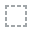
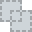
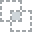
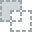
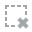
...
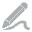
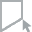
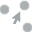
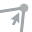
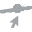

In [ ]:
plot_missing(dados) #verificando se há células com valores missing

- A partir da avaliação dos dados acima, é previsível que: apesar do conjunto de dados conter 1925 linhas, há apenas 385 pacientes, justificados pelo máximo da coluna PATIENT_VISIT_IDENTIFIER. Portanto, será necessária a normalização dos dados nas seções seguintes.

- De acordo com as orientações presentes no próprio Kaggle das informações referentes aos dados, idealmente devemos trabalhar apenas com os dados da primeira janela, isto é, deve-se evitar usar os dados em que o paciente esteja na UTI, portanto, ICU igual à 1 já na primeira janela (de 0 a 2 horas).

- Diante do exposto acima, 50,3% das células possuem valores faltantes, contendo 1380 linhas com valores NA ou NaN.

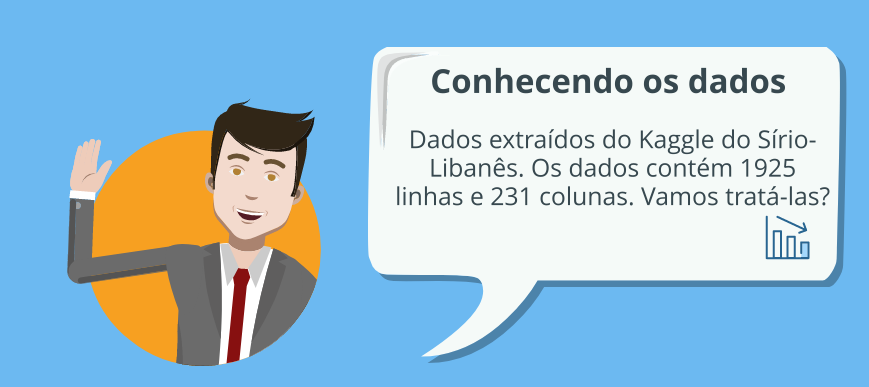

### **2.1 Como provar que há apenas 385 pacientes, e não 1925?**

Diante da seguinte proposição, como alertado anteriormente, devemos avaliar quantos pacientes ao menos "chegaram" ao hospital, independente de sua condição. Para realizar tal proposta, será necessária a contagem de quantas instâncias contém a coluna WINDOW igual à 0-2.

In [ ]:
qt_pacientes = len(dados[dados['WINDOW'] == "0-2"])
print(f'O conjunto de dados contém {qt_pacientes} pacientes únicos.')

O conjunto de dados contém 385 pacientes únicos.


- De fato, a hipótese foi constatada e, assim, podemos considerar a existência de 385 pacientes no conjunto de dados.

### **2.2 Se há 385 pacientes no conjunto de dados, como poderei trabalhar com as 1925 instãncias?**

Primeiramente deve-se verificar como se comportam os dados quando a janela é de 0 a 2 horas, em relação aos dados faltantes:

In [ ]:
dados[dados['WINDOW'] =='0-2'].isna().sum()

PATIENT_VISIT_IDENTIFIER              0
AGE_ABOVE65                           0
AGE_PERCENTIL                         0
GENDER                                0
DISEASE GROUPING 1                    1
DISEASE GROUPING 2                    1
DISEASE GROUPING 3                    1
DISEASE GROUPING 4                    1
DISEASE GROUPING 5                    1
DISEASE GROUPING 6                    1
HTN                                   1
IMMUNOCOMPROMISED                     1
OTHER                                 1
ALBUMIN_MEDIAN                      213
ALBUMIN_MEAN                        213
ALBUMIN_MIN                         213
ALBUMIN_MAX                         213
ALBUMIN_DIFF                        213
BE_ARTERIAL_MEDIAN                  213
BE_ARTERIAL_MEAN                    213
BE_ARTERIAL_MIN                     213
BE_ARTERIAL_MAX                     213
BE_ARTERIAL_DIFF                    213
BE_VENOUS_MEDIAN                    213
BE_VENOUS_MEAN                      213


Conforme é visível na saída acima, quando há essa janela é previsível que haja valores NAs ou NaNs em algumas colunas. Diante desse pressuposto, será necessáro o tratramento desses dados:

Uma **metodologia** a ser seguida é a baseada nas preposições e nos artíficios da estratégia "bfill" e "ffill". De acordo com a mesma, os dados anteriores e posteriores, apesar de vazios, são preenchidos de acordo com a série a partir da repetição do valor (anterior ou posterior). **Por quê realizar isso?**

1. Esse método assume a baixa volatilidade dos valores;
2. É uma recomendação do próprio Sírio-Libanês em relação ao tratamento das variáveis.



### **2.3 Função para preencher os valores**

Recomendação do Sírio-Libanês: É razoável supor que um paciente que não tem uma medição registrada em uma janela de tempo esteja clinicamente estável, podendo apresentar sinais vitais e exames de sangue semelhantes às janelas vizinhas. Portanto, pode-se preencher os valores ausentes usando a entrada seguinte ou anterior. Atenção aos problemas de multicolinearidade e variância zero nesses dados ao escolher seu algoritmo.

In [ ]:
def preenche_tabela(dados): #criando e definindo uma funçã
    '''
    O que esta função está realizando? De modo geral, procura  utilizar o groupby a partir do PATIENT_VISIT_IDENTIFIER, 
    Assim, para preencher os valores usando o bfill e o ffill
   '''
    features_continuas_colunas = dados.iloc[:, 13:-2].columns #determinando as colunas que contém valores contínuos 
    features_continuas = dados.groupby("PATIENT_VISIT_IDENTIFIER", as_index=False)[features_continuas_colunas].fillna(method='bfill').fillna(method='ffill') #utilizando os métodos bfill e ffill
    features_categoricas = dados.iloc[:, :13] #determinando as colunas que são fatores
    saida = dados.iloc[:, -2:] 
    dados_finais = pd.concat([features_categoricas, features_continuas, saida], ignore_index=True,axis=1) #concatenando os dados a partir das colunas
    dados_finais.columns = dados.columns
    return dados_finais

dados_limpos = preenche_tabela(dados)
dados_limpos.head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEDIAN,ALBUMIN_MEAN,ALBUMIN_MIN,ALBUMIN_MAX,ALBUMIN_DIFF,BE_ARTERIAL_MEDIAN,BE_ARTERIAL_MEAN,BE_ARTERIAL_MIN,BE_ARTERIAL_MAX,BE_ARTERIAL_DIFF,BE_VENOUS_MEDIAN,BE_VENOUS_MEAN,BE_VENOUS_MIN,BE_VENOUS_MAX,BE_VENOUS_DIFF,BIC_ARTERIAL_MEDIAN,BIC_ARTERIAL_MEAN,BIC_ARTERIAL_MIN,BIC_ARTERIAL_MAX,BIC_ARTERIAL_DIFF,BIC_VENOUS_MEDIAN,BIC_VENOUS_MEAN,BIC_VENOUS_MIN,BIC_VENOUS_MAX,BIC_VENOUS_DIFF,BILLIRUBIN_MEDIAN,BILLIRUBIN_MEAN,BILLIRUBIN_MIN,BILLIRUBIN_MAX,BILLIRUBIN_DIFF,BLAST_MEDIAN,BLAST_MEAN,BLAST_MIN,BLAST_MAX,BLAST_DIFF,CALCIUM_MEDIAN,CALCIUM_MEAN,CALCIUM_MIN,CALCIUM_MAX,CALCIUM_DIFF,CREATININ_MEDIAN,CREATININ_MEAN,CREATININ_MIN,CREATININ_MAX,CREATININ_DIFF,FFA_MEDIAN,FFA_MEAN,FFA_MIN,FFA_MAX,FFA_DIFF,GGT_MEDIAN,GGT_MEAN,GGT_MIN,GGT_MAX,GGT_DIFF,GLUCOSE_MEDIAN,GLUCOSE_MEAN,GLUCOSE_MIN,GLUCOSE_MAX,GLUCOSE_DIFF,HEMATOCRITE_MEDIAN,HEMATOCRITE_MEAN,HEMATOCRITE_MIN,HEMATOCRITE_MAX,HEMATOCRITE_DIFF,HEMOGLOBIN_MEDIAN,HEMOGLOBIN_MEAN,HEMOGLOBIN_MIN,HEMOGLOBIN_MAX,HEMOGLOBIN_DIFF,INR_MEDIAN,INR_MEAN,INR_MIN,INR_MAX,INR_DIFF,LACTATE_MEDIAN,LACTATE_MEAN,LACTATE_MIN,LACTATE_MAX,LACTATE_DIFF,LEUKOCYTES_MEDIAN,LEUKOCYTES_MEAN,LEUKOCYTES_MIN,LEUKOCYTES_MAX,LEUKOCYTES_DIFF,LINFOCITOS_MEDIAN,LINFOCITOS_MEAN,LINFOCITOS_MIN,LINFOCITOS_MAX,LINFOCITOS_DIFF,NEUTROPHILES_MEDIAN,NEUTROPHILES_MEAN,NEUTROPHILES_MIN,NEUTROPHILES_MAX,NEUTROPHILES_DIFF,P02_ARTERIAL_MEDIAN,P02_ARTERIAL_MEAN,P02_ARTERIAL_MIN,P02_ARTERIAL_MAX,P02_ARTERIAL_DIFF,P02_VENOUS_MEDIAN,P02_VENOUS_MEAN,P02_VENOUS_MIN,P02_VENOUS_MAX,P02_VENOUS_DIFF,PC02_ARTERIAL_MEDIAN,PC02_ARTERIAL_MEAN,PC02_ARTERIAL_MIN,PC02_ARTERIAL_MAX,PC02_ARTERIAL_DIFF,PC02_VENOUS_MEDIAN,PC02_VENOUS_MEAN,PC02_VENOUS_MIN,PC02_VENOUS_MAX,PC02_VENOUS_DIFF,PCR_MEDIAN,PCR_MEAN,PCR_MIN,PCR_MAX,PCR_DIFF,PH_ARTERIAL_MEDIAN,PH_ARTERIAL_MEAN,PH_ARTERIAL_MIN,PH_ARTERIAL_MAX,PH_ARTERIAL_DIFF,PH_VENOUS_MEDIAN,PH_VENOUS_MEAN,PH_VENOUS_MIN,PH_VENOUS_MAX,PH_VENOUS_DIFF,PLATELETS_MEDIAN,PLATELETS_MEAN,PLATELETS_MIN,PLATELETS_MAX,PLATELETS_DIFF,POTASSIUM_MEDIAN,POTASSIUM_MEAN,POTASSIUM_MIN,POTASSIUM_MAX,POTASSIUM_DIFF,SAT02_ARTERIAL_MEDIAN,SAT02_ARTERIAL_MEAN,SAT02_ARTERIAL_MIN,SAT02_ARTERIAL_MAX,SAT02_ARTERIAL_DIFF,SAT02_VENOUS_MEDIAN,SAT02_VENOUS_MEAN,SAT02_VENOUS_MIN,SAT02_VENOUS_MAX,SAT02_VENOUS_DIFF,SODIUM_MEDIAN,SODIUM_MEAN,SODIUM_MIN,SODIUM_MAX,SODIUM_DIFF,TGO_MEDIAN,TGO_MEAN,TGO_MIN,TGO_MAX,TGO_DIFF,TGP_MEDIAN,TGP_MEAN,TGP_MIN,TGP_MAX,TGP_DIFF,TTPA_MEDIAN,TTPA_MEAN,TTPA_MIN,TTPA_MAX,TTPA_DIFF,UREA_MEDIAN,UREA_MEAN,UREA_MIN,UREA_MAX,UREA_DIFF,DIMER_MEDIAN,DIMER_MEAN,DIMER_MIN,DIMER_MAX,DIMER_DIFF,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_MEDIAN,BLOODPRESSURE_SISTOLIC_MEDIAN,HEART_RATE_MEDIAN,RESPIRATORY_RATE_MEDIAN,TEMPERATURE_MEDIAN,OXYGEN_SATURATION_MEDIAN,BLOODPRESSURE_DIASTOLIC_MIN,BLOODPRESSURE_SISTOLIC_MIN,HEART_RATE_MIN,RESPIRATORY_RATE_MIN,TEMPERATURE_MIN,OXYGEN_SATURATION_MIN,BLOODPRESSURE_DIASTOLIC_MAX,BLOODPRESSURE_SISTOLIC_MAX,HEART_RATE_MAX,RESPIRATORY_RATE_MAX,TEMPERATURE_MAX,OXYGEN_SATURATION_MAX,BLOODPRESSURE_DIASTOLIC_DIFF,BLOODPRESSURE_SISTOLIC_DIFF,HEART_RATE_DIFF,RESPIRATORY_RATE_DIFF,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,60th,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,0.605263,0.605263,0.605263,-1.0,-1.000000,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,-1.000000,-1.000000,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.938950,-0.938950,-0.938950,-0.938950,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,0.183673,0.183673,0.183673,0.183673,-1.0,-0.868365,-0.868365,-0.

In [ ]:
dados_limpos[dados_limpos['WINDOW'] =='0-2'].isna().sum()

PATIENT_VISIT_IDENTIFIER            0
AGE_ABOVE65                         0
AGE_PERCENTIL                       0
GENDER                              0
DISEASE GROUPING 1                  1
DISEASE GROUPING 2                  1
DISEASE GROUPING 3                  1
DISEASE GROUPING 4                  1
DISEASE GROUPING 5                  1
DISEASE GROUPING 6                  1
HTN                                 1
IMMUNOCOMPROMISED                   1
OTHER                               1
ALBUMIN_MEDIAN                      0
ALBUMIN_MEAN                        0
ALBUMIN_MIN                         0
ALBUMIN_MAX                         0
ALBUMIN_DIFF                        0
BE_ARTERIAL_MEDIAN                  0
BE_ARTERIAL_MEAN                    0
BE_ARTERIAL_MIN                     0
BE_ARTERIAL_MAX                     0
BE_ARTERIAL_DIFF                    0
BE_VENOUS_MEDIAN                    0
BE_VENOUS_MEAN                      0
BE_VENOUS_MIN                       0
BE_VENOUS_MA

Diante do tratamento da base de dados, é visível que ao menos todas outras colunas foram tratadas. As colunas que se referem às doenças contém, ainda, valores nulos. Vamos analisar:

In [ ]:
dados_limpos.loc[dados_limpos['DISEASE GROUPING 1'].isna()]

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEDIAN,ALBUMIN_MEAN,ALBUMIN_MIN,ALBUMIN_MAX,ALBUMIN_DIFF,BE_ARTERIAL_MEDIAN,BE_ARTERIAL_MEAN,BE_ARTERIAL_MIN,BE_ARTERIAL_MAX,BE_ARTERIAL_DIFF,BE_VENOUS_MEDIAN,BE_VENOUS_MEAN,BE_VENOUS_MIN,BE_VENOUS_MAX,BE_VENOUS_DIFF,BIC_ARTERIAL_MEDIAN,BIC_ARTERIAL_MEAN,BIC_ARTERIAL_MIN,BIC_ARTERIAL_MAX,BIC_ARTERIAL_DIFF,BIC_VENOUS_MEDIAN,BIC_VENOUS_MEAN,BIC_VENOUS_MIN,BIC_VENOUS_MAX,BIC_VENOUS_DIFF,BILLIRUBIN_MEDIAN,BILLIRUBIN_MEAN,BILLIRUBIN_MIN,BILLIRUBIN_MAX,BILLIRUBIN_DIFF,BLAST_MEDIAN,BLAST_MEAN,BLAST_MIN,BLAST_MAX,BLAST_DIFF,CALCIUM_MEDIAN,CALCIUM_MEAN,CALCIUM_MIN,CALCIUM_MAX,CALCIUM_DIFF,CREATININ_MEDIAN,CREATININ_MEAN,CREATININ_MIN,CREATININ_MAX,CREATININ_DIFF,FFA_MEDIAN,FFA_MEAN,FFA_MIN,FFA_MAX,FFA_DIFF,GGT_MEDIAN,GGT_MEAN,GGT_MIN,GGT_MAX,GGT_DIFF,GLUCOSE_MEDIAN,GLUCOSE_MEAN,GLUCOSE_MIN,GLUCOSE_MAX,GLUCOSE_DIFF,HEMATOCRITE_MEDIAN,HEMATOCRITE_MEAN,HEMATOCRITE_MIN,HEMATOCRITE_MAX,HEMATOCRITE_DIFF,HEMOGLOBIN_MEDIAN,HEMOGLOBIN_MEAN,HEMOGLOBIN_MIN,HEMOGLOBIN_MAX,HEMOGLOBIN_DIFF,INR_MEDIAN,INR_MEAN,INR_MIN,INR_MAX,INR_DIFF,LACTATE_MEDIAN,LACTATE_MEAN,LACTATE_MIN,LACTATE_MAX,LACTATE_DIFF,LEUKOCYTES_MEDIAN,LEUKOCYTES_MEAN,LEUKOCYTES_MIN,LEUKOCYTES_MAX,LEUKOCYTES_DIFF,LINFOCITOS_MEDIAN,LINFOCITOS_MEAN,LINFOCITOS_MIN,LINFOCITOS_MAX,LINFOCITOS_DIFF,NEUTROPHILES_MEDIAN,NEUTROPHILES_MEAN,NEUTROPHILES_MIN,NEUTROPHILES_MAX,NEUTROPHILES_DIFF,P02_ARTERIAL_MEDIAN,P02_ARTERIAL_MEAN,P02_ARTERIAL_MIN,P02_ARTERIAL_MAX,P02_ARTERIAL_DIFF,P02_VENOUS_MEDIAN,P02_VENOUS_MEAN,P02_VENOUS_MIN,P02_VENOUS_MAX,P02_VENOUS_DIFF,PC02_ARTERIAL_MEDIAN,PC02_ARTERIAL_MEAN,PC02_ARTERIAL_MIN,PC02_ARTERIAL_MAX,PC02_ARTERIAL_DIFF,PC02_VENOUS_MEDIAN,PC02_VENOUS_MEAN,PC02_VENOUS_MIN,PC02_VENOUS_MAX,PC02_VENOUS_DIFF,PCR_MEDIAN,PCR_MEAN,PCR_MIN,PCR_MAX,PCR_DIFF,PH_ARTERIAL_MEDIAN,PH_ARTERIAL_MEAN,PH_ARTERIAL_MIN,PH_ARTERIAL_MAX,PH_ARTERIAL_DIFF,PH_VENOUS_MEDIAN,PH_VENOUS_MEAN,PH_VENOUS_MIN,PH_VENOUS_MAX,PH_VENOUS_DIFF,PLATELETS_MEDIAN,PLATELETS_MEAN,PLATELETS_MIN,PLATELETS_MAX,PLATELETS_DIFF,POTASSIUM_MEDIAN,POTASSIUM_MEAN,POTASSIUM_MIN,POTASSIUM_MAX,POTASSIUM_DIFF,SAT02_ARTERIAL_MEDIAN,SAT02_ARTERIAL_MEAN,SAT02_ARTERIAL_MIN,SAT02_ARTERIAL_MAX,SAT02_ARTERIAL_DIFF,SAT02_VENOUS_MEDIAN,SAT02_VENOUS_MEAN,SAT02_VENOUS_MIN,SAT02_VENOUS_MAX,SAT02_VENOUS_DIFF,SODIUM_MEDIAN,SODIUM_MEAN,SODIUM_MIN,SODIUM_MAX,SODIUM_DIFF,TGO_MEDIAN,TGO_MEAN,TGO_MIN,TGO_MAX,TGO_DIFF,TGP_MEDIAN,TGP_MEAN,TGP_MIN,TGP_MAX,TGP_DIFF,TTPA_MEDIAN,TTPA_MEAN,TTPA_MIN,TTPA_MAX,TTPA_DIFF,UREA_MEDIAN,UREA_MEAN,UREA_MIN,UREA_MAX,UREA_DIFF,DIMER_MEDIAN,DIMER_MEAN,DIMER_MIN,DIMER_MAX,DIMER_DIFF,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_MEDIAN,BLOODPRESSURE_SISTOLIC_MEDIAN,HEART_RATE_MEDIAN,RESPIRATORY_RATE_MEDIAN,TEMPERATURE_MEDIAN,OXYGEN_SATURATION_MEDIAN,BLOODPRESSURE_DIASTOLIC_MIN,BLOODPRESSURE_SISTOLIC_MIN,HEART_RATE_MIN,RESPIRATORY_RATE_MIN,TEMPERATURE_MIN,OXYGEN_SATURATION_MIN,BLOODPRESSURE_DIASTOLIC_MAX,BLOODPRESSURE_SISTOLIC_MAX,HEART_RATE_MAX,RESPIRATORY_RATE_MAX,TEMPERATURE_MAX,OXYGEN_SATURATION_MAX,BLOODPRESSURE_DIASTOLIC_DIFF,BLOODPRESSURE_SISTOLIC_DIFF,HEART_RATE_DIFF,RESPIRATORY_RATE_DIFF,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
995,199,0,10th,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.605263,0.605263,0.605263,0.605263,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.93895,-0.93895,-0.93895,-0.93895,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,0.357143,0.357143,0.357143,0.357143,-1.0,-0.913659,-0.913659,-0.913659,-0.913659,-1.0,-0.742004,-0.74200

O paciente 199 não apresentou nenhuma doença (contém valores NaN), e também não foi para UTI, isto é, ICU == 0 em todas as janelas. A fim de tornar o dataset mais saudável, estarei excluindo seus dados.

In [ ]:
dados_limpos = dados_limpos.dropna() #dropando as linhas/colunas que ainda possuem valores NaN.
dados_limpos[dados_limpos['WINDOW'] =='0-2'].isna().sum()

PATIENT_VISIT_IDENTIFIER            0
AGE_ABOVE65                         0
AGE_PERCENTIL                       0
GENDER                              0
DISEASE GROUPING 1                  0
DISEASE GROUPING 2                  0
DISEASE GROUPING 3                  0
DISEASE GROUPING 4                  0
DISEASE GROUPING 5                  0
DISEASE GROUPING 6                  0
HTN                                 0
IMMUNOCOMPROMISED                   0
OTHER                               0
ALBUMIN_MEDIAN                      0
ALBUMIN_MEAN                        0
ALBUMIN_MIN                         0
ALBUMIN_MAX                         0
ALBUMIN_DIFF                        0
BE_ARTERIAL_MEDIAN                  0
BE_ARTERIAL_MEAN                    0
BE_ARTERIAL_MIN                     0
BE_ARTERIAL_MAX                     0
BE_ARTERIAL_DIFF                    0
BE_VENOUS_MEDIAN                    0
BE_VENOUS_MEAN                      0
BE_VENOUS_MIN                       0
BE_VENOUS_MA

Diante do exposto, o dataser foi tratato com sucesso referente aos valores nulos/faltantes.

Conforme as orientações do próprio Síro-Libanês, pacientes que em primeira janela já foram submetidos à UTI deverão ser desconsiderados a fim de tornar mais hábil as features. Assim, irei eliminar tais pacientes com uma simples query:

In [ ]:
pacientes_remover = dados_limpos.query("WINDOW=='0-2' and ICU==1")['PATIENT_VISIT_IDENTIFIER'].values
dados_limpos = dados_limpos.query("PATIENT_VISIT_IDENTIFIER not in @pacientes_remover")

linhas, colunas = dados_limpos.shape #extraindo o número de linhas e colunas do dataset atual
print(f'O dataset possui {linhas} linhas com {colunas} features.')

O dataset possui 1760 linhas com 231 features.


### **2.4 Função para preencher a janela de 0 a 2 horas.**

Recomendação do Sírio-Libanês: Enquanto um modelo preditivo usando todas as janelas de tempo provavelmente produzirá uma maior precisão, um bom modelo usando apenas o primeiro (0-2) provavelmente será mais clinicamente relevante.

In [ ]:
def prepare_window(rows): #definindo e criando a função
    '''
    O que esta função está realizando? A mesma tenta adequar os dados de acordo com as diretrizes do Sírio-Libanês
    Onde visa extrair a informação de que o paciente foi ou não para UTI, independente da janela de tempo,
    assim, concatenando essa informação através do .loc na janela 0-2.
   '''
    if(np.any(rows["ICU"])):
        rows.loc[rows["WINDOW"]=="0-2", "ICU"] = 1
    return rows.loc[rows["WINDOW"] == "0-2"]

Com a função criada, pode-se extrair a informação necessária (foi ou não para UTI) em apenas uma linha, a fim de criar uma instância para um único paciente.

In [ ]:
dados_limpos = dados_limpos.groupby("PATIENT_VISIT_IDENTIFIER").apply(prepare_window).set_index('PATIENT_VISIT_IDENTIFIER').reset_index()

resposta = {'10th' : 0, '20th' : 1,'30th' : 2, '40th' : 3, '50th' : 4, '60th' : 5, '70th' : 6, '80th' : 7, '90th' : 8, 'Above 90th': 9}
dados_limpos.AGE_PERCENTIL = dados_limpos.AGE_PERCENTIL.replace(resposta)

linhas, colunas = dados_limpos.shape #extraindo o número de linhas e colunas do dataset atual
print(f'O dataset possui {linhas} linhas com {colunas} features.')

O dataset possui 352 linhas com 231 features.


### **2.5 E quais colunas são mais úteis para as análises?**

De fato, esse é um embate a ser definido antes da produção dos modelos, a fim de tornar mais qualificável o dataset.  Iremos analisar o dataset a seguir:

In [ ]:
dados_limpos.head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEDIAN,ALBUMIN_MEAN,ALBUMIN_MIN,ALBUMIN_MAX,ALBUMIN_DIFF,BE_ARTERIAL_MEDIAN,BE_ARTERIAL_MEAN,BE_ARTERIAL_MIN,BE_ARTERIAL_MAX,BE_ARTERIAL_DIFF,BE_VENOUS_MEDIAN,BE_VENOUS_MEAN,BE_VENOUS_MIN,BE_VENOUS_MAX,BE_VENOUS_DIFF,BIC_ARTERIAL_MEDIAN,BIC_ARTERIAL_MEAN,BIC_ARTERIAL_MIN,BIC_ARTERIAL_MAX,BIC_ARTERIAL_DIFF,BIC_VENOUS_MEDIAN,BIC_VENOUS_MEAN,BIC_VENOUS_MIN,BIC_VENOUS_MAX,BIC_VENOUS_DIFF,BILLIRUBIN_MEDIAN,BILLIRUBIN_MEAN,BILLIRUBIN_MIN,BILLIRUBIN_MAX,BILLIRUBIN_DIFF,BLAST_MEDIAN,BLAST_MEAN,BLAST_MIN,BLAST_MAX,BLAST_DIFF,CALCIUM_MEDIAN,CALCIUM_MEAN,CALCIUM_MIN,CALCIUM_MAX,CALCIUM_DIFF,CREATININ_MEDIAN,CREATININ_MEAN,CREATININ_MIN,CREATININ_MAX,CREATININ_DIFF,FFA_MEDIAN,FFA_MEAN,FFA_MIN,FFA_MAX,FFA_DIFF,GGT_MEDIAN,GGT_MEAN,GGT_MIN,GGT_MAX,GGT_DIFF,GLUCOSE_MEDIAN,GLUCOSE_MEAN,GLUCOSE_MIN,GLUCOSE_MAX,GLUCOSE_DIFF,HEMATOCRITE_MEDIAN,HEMATOCRITE_MEAN,HEMATOCRITE_MIN,HEMATOCRITE_MAX,HEMATOCRITE_DIFF,HEMOGLOBIN_MEDIAN,HEMOGLOBIN_MEAN,HEMOGLOBIN_MIN,HEMOGLOBIN_MAX,HEMOGLOBIN_DIFF,INR_MEDIAN,INR_MEAN,INR_MIN,INR_MAX,INR_DIFF,LACTATE_MEDIAN,LACTATE_MEAN,LACTATE_MIN,LACTATE_MAX,LACTATE_DIFF,LEUKOCYTES_MEDIAN,LEUKOCYTES_MEAN,LEUKOCYTES_MIN,LEUKOCYTES_MAX,LEUKOCYTES_DIFF,LINFOCITOS_MEDIAN,LINFOCITOS_MEAN,LINFOCITOS_MIN,LINFOCITOS_MAX,LINFOCITOS_DIFF,NEUTROPHILES_MEDIAN,NEUTROPHILES_MEAN,NEUTROPHILES_MIN,NEUTROPHILES_MAX,NEUTROPHILES_DIFF,P02_ARTERIAL_MEDIAN,P02_ARTERIAL_MEAN,P02_ARTERIAL_MIN,P02_ARTERIAL_MAX,P02_ARTERIAL_DIFF,P02_VENOUS_MEDIAN,P02_VENOUS_MEAN,P02_VENOUS_MIN,P02_VENOUS_MAX,P02_VENOUS_DIFF,PC02_ARTERIAL_MEDIAN,PC02_ARTERIAL_MEAN,PC02_ARTERIAL_MIN,PC02_ARTERIAL_MAX,PC02_ARTERIAL_DIFF,PC02_VENOUS_MEDIAN,PC02_VENOUS_MEAN,PC02_VENOUS_MIN,PC02_VENOUS_MAX,PC02_VENOUS_DIFF,PCR_MEDIAN,PCR_MEAN,PCR_MIN,PCR_MAX,PCR_DIFF,PH_ARTERIAL_MEDIAN,PH_ARTERIAL_MEAN,PH_ARTERIAL_MIN,PH_ARTERIAL_MAX,PH_ARTERIAL_DIFF,PH_VENOUS_MEDIAN,PH_VENOUS_MEAN,PH_VENOUS_MIN,PH_VENOUS_MAX,PH_VENOUS_DIFF,PLATELETS_MEDIAN,PLATELETS_MEAN,PLATELETS_MIN,PLATELETS_MAX,PLATELETS_DIFF,POTASSIUM_MEDIAN,POTASSIUM_MEAN,POTASSIUM_MIN,POTASSIUM_MAX,POTASSIUM_DIFF,SAT02_ARTERIAL_MEDIAN,SAT02_ARTERIAL_MEAN,SAT02_ARTERIAL_MIN,SAT02_ARTERIAL_MAX,SAT02_ARTERIAL_DIFF,SAT02_VENOUS_MEDIAN,SAT02_VENOUS_MEAN,SAT02_VENOUS_MIN,SAT02_VENOUS_MAX,SAT02_VENOUS_DIFF,SODIUM_MEDIAN,SODIUM_MEAN,SODIUM_MIN,SODIUM_MAX,SODIUM_DIFF,TGO_MEDIAN,TGO_MEAN,TGO_MIN,TGO_MAX,TGO_DIFF,TGP_MEDIAN,TGP_MEAN,TGP_MIN,TGP_MAX,TGP_DIFF,TTPA_MEDIAN,TTPA_MEAN,TTPA_MIN,TTPA_MAX,TTPA_DIFF,UREA_MEDIAN,UREA_MEAN,UREA_MIN,UREA_MAX,UREA_DIFF,DIMER_MEDIAN,DIMER_MEAN,DIMER_MIN,DIMER_MAX,DIMER_DIFF,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_MEDIAN,BLOODPRESSURE_SISTOLIC_MEDIAN,HEART_RATE_MEDIAN,RESPIRATORY_RATE_MEDIAN,TEMPERATURE_MEDIAN,OXYGEN_SATURATION_MEDIAN,BLOODPRESSURE_DIASTOLIC_MIN,BLOODPRESSURE_SISTOLIC_MIN,HEART_RATE_MIN,RESPIRATORY_RATE_MIN,TEMPERATURE_MIN,OXYGEN_SATURATION_MIN,BLOODPRESSURE_DIASTOLIC_MAX,BLOODPRESSURE_SISTOLIC_MAX,HEART_RATE_MAX,RESPIRATORY_RATE_MAX,TEMPERATURE_MAX,OXYGEN_SATURATION_MAX,BLOODPRESSURE_DIASTOLIC_DIFF,BLOODPRESSURE_SISTOLIC_DIFF,HEART_RATE_DIFF,RESPIRATORY_RATE_DIFF,TEMPERATURE_DIFF,OXYGEN_SATURATION_DIFF,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,5,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,0.605263,0.605263,0.605263,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.317073,-0.317073,-0.317073,-0.317073,-1.0,-0.938950,-0.938950,-0.938950,-0.938950,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,0.183673,0.183673,0.183673,0.183673,-1.0,-0.868365,-0.868365,-0.868365,-0.868365,-1.0,-0.742004,-0.742004,-

### **2.6 Função para criar histogramas**

A fim de avaliar os dados, irei criar um a função que cria um histograma em conjunto da média, moda e mediana dos dados:

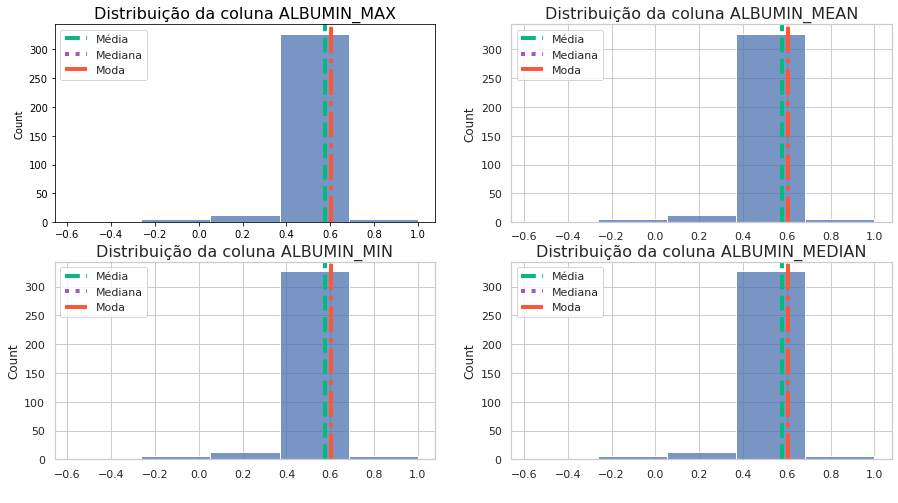

In [ ]:
def create_histogram(data, title, bins = 5, xtitle = ' '):
  '''
  O que esta função faz? Extrai a média, a mediana e a moda dos dados, plota as mesmas na legenda,
  cria um histograma utilizando o seaborn
  '''
#  plt.figure(figsize=(10, 8))
  sns.set_theme(style="whitegrid")
  media = plt.axvline(x = data.mean(), c = "#05BA7F", linewidth = 4, linestyle = '--')
  mediana = plt.axvline(x = data.median(), c = "#A558C4", linewidth = 4, linestyle = ':')
  moda = plt.axvline(x = data.mode()[0], c = "#FF5733", linewidth = 4, linestyle = '-.')
  plt.legend([media, mediana, moda], ['Média', 'Mediana', 'Moda'])
  plt.xlabel(xtitle)
  sns.histplot(data, bins = bins).set_title(title, fontsize = 16);

plt.figure(figsize=(15,8))
plt.subplot(2,2,1)
create_histogram(dados_limpos['ALBUMIN_MAX'], "Distribuição da coluna ALBUMIN_MAX")
plt.subplot(2,2,2)
create_histogram(dados_limpos['ALBUMIN_MEAN'], "Distribuição da coluna ALBUMIN_MEAN")
plt.subplot(2,2,3)
create_histogram(dados_limpos['ALBUMIN_MIN'], "Distribuição da coluna ALBUMIN_MIN")
plt.subplot(2,2,4)
create_histogram(dados_limpos['ALBUMIN_MEDIAN'], "Distribuição da coluna ALBUMIN_MEDIAN")

In [ ]:
dados_limpos['ALBUMIN_DIFF'].mean() #dados categóricos, podem conter correlações e, portanto, não saudáveis para o modelo de machine learning

-1.0

De fato, há muitas variáveis a serem levadas em consideração. Partindo do pressuposto anterior, de que não terá uma volatilidade muito grande entre os valores de máximo e mínimo de cada feature (**por exemplo:** ALBUMIN_MEDIAN	ALBUMIN_MEAN	ALBUMIN_MIN	ALBUMIN_MAX), faz jus a captação da média em relação à realidade dos dados, sendo apta para as seguintes análises. 

Diante disso, estarei extraindo apenas a média de cada feature ao tornar os dados mais limpos e fluidos para os passos seguintes:

In [ ]:
nomenclaturas_removidas = ['MIN', 'MAX', 'MEDIAN', 'DIFF']

lista = []
for nomenclatura in nomenclaturas_removidas:
  for column in dados_limpos.columns:
    if column.endswith(nomenclatura):
      lista.append(column)

dados_limpos_features = dados_limpos.drop(lista,axis=1)

In [ ]:
dados_limpos_features.head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMATOCRITE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LEUKOCYTES_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SAT02_VENOUS_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU
0,0,1,5,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.183673,-0.868365,-0.742004,-0.945093,-0.891993,0.090147,0.109756,-0.932246,1.000000,-0.835844,-0.914938,-0.868747,-0.170732,-0.704142,-0.77931,-0.754601,-0.875236,0.234043,0.363636,-0.540721,-0.518519,0.939394,0.345679,-0.028571,-0.997201,-0.990854,-0.825613,-0.836145,-0.994912,0.086420,-0.230769,-0.283019,-0.593220,-0.285714,0.736842,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,1
1,2,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.912243,-0.742004,-0.958528,-0.780261,0.144654,0.158537,-0.959849,1.000000,-0.382773,-0.908714,-0.412965,-0.170732,-0.704142,-0.77931,-0.754601,-0.939887,0.234043,0.363636,-0.399199,-0.703704,0.939394,0.345679,0.085714,-0.995428,-0.986662,-0.846633,-0.836145,-0.978029,-0.489712,-0.685470,-0.048218,-0.645951,0.357143,0.935673,-0.515528,-0.351328,-0.747001,-0.756272,-1.000000,-0.961262,0-2,1
2,3,0,3,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,-0.263158,-1.0,-1.0,-0.317073,-0.317073,-0.972789,-1.0,0.326531,-0.968861,-0.194030,-0.316589,-0.891993,-0.203354,-0.219512,-0.959849,-0.828421,-0.729239,-0.836100,-0.784714,-0.170732,-0.633136,-0.77931,-0.779141,-0.503592,0.234043,0.363636,-0.564753,-0.777778,0.939394,0.580247,0.200000,-0.989549,-0.956555,-0.846633,-0.937349,-0.978029,0.012346,-0.369231,-0.528302,-0.457627,-0.285714,0.684211,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,0
3,4,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.935113,-1.0,0.357143,-0.913659,-0.829424,-0.938084,-0.851024,0.358491,0.304878,-0.959849,1.000000,-0.702202,-0.641079,-0.812725,-0.170732,-0.704142,-0.77931,-0.754601,-0.990926,0.234043,0.363636,-0.457944,-0.592593,0.939394,0.345679,0.142857,-0.998507,-0.991235,-0.846633,-0.903614,-1.000000,0.333333,-0.153846,0.160377,-0.593220,0.285714,0.868421,-1.000000,-0.883669,-0.956805,-0.870968,-0.953536,-0.980333,0-2,0
4,5,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.891012,-0.742004,-0.958528,-0.891993,0.291405,0.243902,-0.959849,1.000000,-0.706450,-0.340249,-0.846339,-0.170732,-0.704142,-0.77931,-0.754601,-0.997732,0.234043,0.363636,-0.292390,-0.666667,0.939394,0.345679,0.085714,-0.997947,-0.988948,-0.846633,-0.884337,-1.000000,-0.037037,-0.538462,-0.537736,-0.525424,-0.196429,0.815789,-0.860870,-0.714460,-0.986481,-1.000000,-0.975891,-0.980129,0-2,0


In [ ]:
linhas, colunas = dados_limpos_features.shape
print(f'Os dados limpos no momentos, após a remoção das colunas indesejadas, contém {linhas} pacientes e {colunas} colunas.')

Os dados limpos no momentos, após a remoção das colunas indesejadas, contém 352 pacientes e 63 colunas.



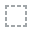
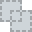
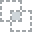
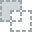
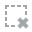
...
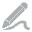
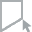
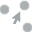
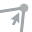
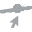

In [ ]:
plot_missing(dados_limpos_features)

Além disso, é visível nos gráficos e na tabela acima (do pacote dataprep) que o conjunto de dados não possui valores missing.

### **2.7 Conclusão sobre o tratamento dos dados**

- Os dados foram, de modo geral, reduzidos de maneira eficiente a tornar mais saudável a análise, tornando coerente os dados de acordo com a proposta do projeto: determinar quais pacientes terão de ir para UTI ou não.

- A fim de tornar essa informação clara para exploração, os dados foram escalonados e estratificados pela coluna ICU, coluna em valores booleanos, para concatenar a informação com os dados anteriores.

- Inicialmente os dados possuiam 1925 linhas, isto é, haviam linhas com "pacientes repitidos" para cada janela de tempo. Após a aplicação dos métodos bfill e ffill, como também a extração da informação ICU, os dados terminaram em 352 pacientes (que não foram para UTI a priori), sem valores faltantes e com 213 colunas tratáveis.

- Diante do exposto, apesar da redução dos pacientes, obtive a solução em diminuir as features que demonstravam "valores repetidos", assim reduzindo para 63 colunas, priorizando a média, dito que a volatilidade dos dados é pequena.

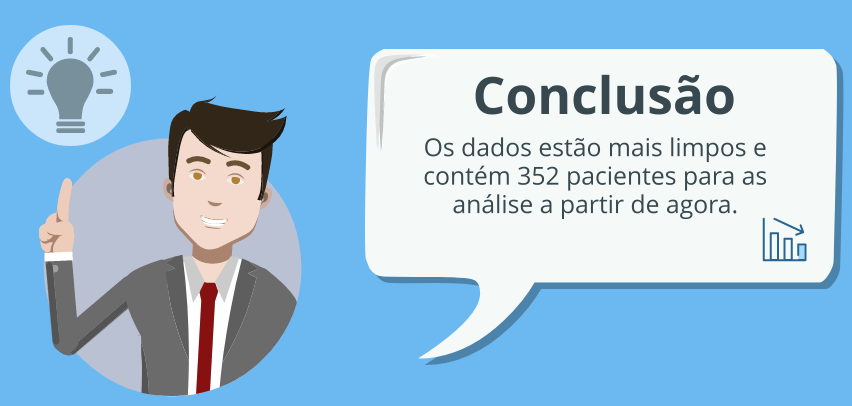

### **2.8 Sugestão de features do Sírio-Libanês**

Do ponto de vista biológico, o próprio Sírio-Libanês sugestionou a seleção de algumas colunas para tornar o dataset mais interessantes do ponto de vista do time do Sírio libânes.  A partir da criação da tabela, irei utilizar os dados limpos sem as colunas retiradas por mim, a fim de poder selecionar outras pela função:

In [ ]:
def makebio_df(df:pd.DataFrame):
    
    df["BLOODPRESSURE_ARTERIAL_MEAN"] = (df['BLOODPRESSURE_SISTOLIC_MEAN'] + 2*df['BLOODPRESSURE_DIASTOLIC_MEAN'])/3
 
    # df["NEUTROPHILES/LINFOCITOS"] = df['NEUTROPHILES_MEAN']/df['LINFOCITOS_MEAN'] pode causar uma possível correlação
    
    df["GASO"] = df.groupby("PATIENT_VISIT_IDENTIFIER").P02_ARTERIAL_MEAN.apply(lambda x: x.fillna(method='ffill'))
    df["GASO"] = (~df["GASO"].isna()).astype(int)
    
    return df[["ICU","WINDOW",
               "PATIENT_VISIT_IDENTIFIER",
               "AGE_ABOVE65", 
               "GENDER", 
               "BLOODPRESSURE_ARTERIAL_MEAN", 
               "RESPIRATORY_RATE_MAX", 
               "HTN", 
               'DISEASE GROUPING 1',
               'DISEASE GROUPING 2',
               'DISEASE GROUPING 3',
               'DISEASE GROUPING 4',
               'DISEASE GROUPING 5',
               'DISEASE GROUPING 6',
               "GASO",
               "OXYGEN_SATURATION_MIN",
               "HEART_RATE_MAX",
               "PCR_MEAN",
               "CREATININ_MEAN"]]

features_sirio = dados_limpos.copy()
features_sirio = makebio_df(features_sirio)
features_sirio.head()

,ICU,WINDOW,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,GENDER,BLOODPRESSURE_ARTERIAL_MEAN,RESPIRATORY_RATE_MAX,HTN,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,GASO,OXYGEN_SATURATION_MIN,HEART_RATE_MAX,PCR_MEAN,CREATININ_MEAN
0,1,0-2,0,1,0,-0.019310,-0.636364,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1,0.898990,-0.432836,-0.875236,-0.868365
1,1,0-2,2,0,0,-0.554965,-0.575758,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.959596,0.000000,-0.939887,-0.912243
2,0,0-2,3,0,1,-0.114846,-0.515152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.878788,-0.626866,-0.503592,-0.968861
3,0,0-2,4,0,0,0.170940,-0.575758,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.939394,-0.044776,-0.990926,-0.913659
4,0,0-2,5,0,0,-0.204179,-0.575758,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.919192,-0.626866,-0.997732,-0.891012


In [ ]:
linhas, colunas = features_sirio.shape
print(f'Os dados com as colunas do Sírio-Libanês contém {linhas} pacientes e {colunas} colunas.')

Os dados com as colunas do Sírio-Libanês contém 352 pacientes e 19 colunas.



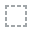
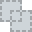
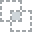
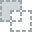
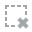
...
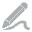
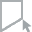
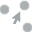
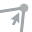
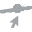

In [ ]:
plot_missing(features_sirio)

Além disso, como no dataset anterior já foi previsto, os dados possuem 0% de NaN ou NA.

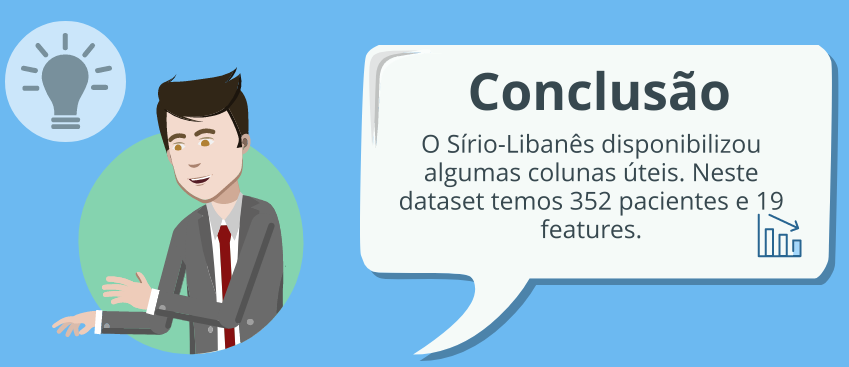

# **3. Análise dos dados**

## **3.1 Dados selecionados**

A presente seção visa analisar os dados selecionados anteriormente para contribuir para as análises seguintes e para construção do próprio modelo. A análise será baseada na primícia da EDA (*Exploratory Data Analysis*), isto é, baseada em uma abordagem à análise de conjuntos de dados de modo a resumir suas características principais, frequentemente com métodos visuais

![](https://raw.githubusercontent.com/sfu-db/dataprep/develop/assets/logo_cropped.jpg)

A biblitoeca **Dataprep** procura promover uma rápida e ágil análise em referência dos dados priorizados nas funções. Irei construir a maioria das análises sob esta biblioteca, para fins de maior precisão na interpretação.

- Para construção a cronologia analítica, estarei utilizando da biblioteca "dataprep", já utilizada anterioremente. A priori, focarei na função plot() que explora as distribuições e estatísticas do conjunto de dados. Gera uma variedade de visualizações e estatísticas que permitem ao usuário obter uma compreensão abrangente das distribuições das colunas e seus relacionamentos. O seguinte descreve a funcionalidade do plot() para um determinado dataframe df.

Mais informações podem ser encontradas através da docentação da biblioteca pelo seguinte link: https://docs.dataprep.ai/user_guide/eda/plot.html


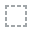
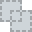
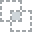
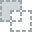
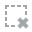
...
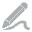
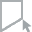
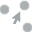
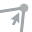
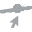

In [ ]:
plot(dados_limpos_features) #visualize os gráficos pela saída desta célula (use o scroll para ver todos)

De modo geral, há variáveis que contém apenas valores 0 ou 1, como também há variáveis que apresentam uma distribuição similar à distribuição normal. Há distribuições à direita, como à esquerda. Esses são efeitos do desvio padrão, ou da variância, sobre a própria média inferindo sobre os valores. 

- Ponto: é importante ressaltar que através do gráfico extraído da coluna "AGE_ABOVE65", isto é, se o paciente possui acima de 65 anos, demonstra que quase da metade do dataset possui mais de 65 anos no insight - AGE_ABOVE65 has 191 (54.26%) zeros -.

- Hipótese: a idade é um fator inferencial sob às complicações do COVID-19.

A seguir, é possível visualizar algumas variáveis do conjunto de dados que possuem uma distribuição similar, levando quesitos na importância dos dados:

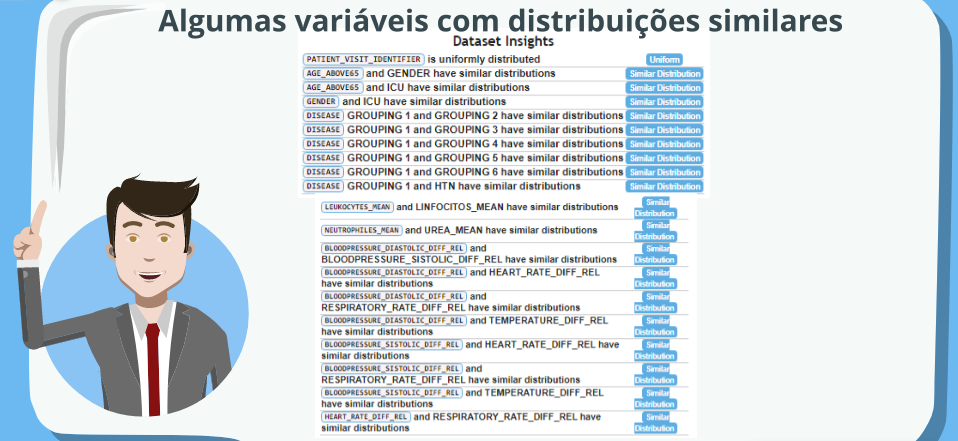

### **3.1.1 Analisando a faixa etária**

A partir dos dados selecionados, iremos analisar a idade para fins do comportamento do modelo:

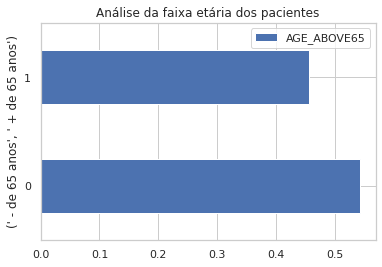

In [ ]:
pd.DataFrame(dados_limpos_features['AGE_ABOVE65'].value_counts(normalize = True)).plot.barh()
plt.title("Análise da faixa etária dos pacientes")
plt.ylabel((' - de 65 anos', ' + de 65 anos'));

De fato, de forma aparente no gráfico, é possível visualizar que quase metade dos dados é composto de paciente com mais de 65 anos.

### **3.1.2 Analisando a correlação de variáveis**

Diante das distribuições similares (podem ser vistas em Show stats and insights da biblioteca dataprep), pode-se analisar a correlação entre essas variáveis, a fim de "limpar" os dados. Uma correlação infere diretamente no progesso do machine learning, assim prejudicando alguns argumentos e artifícios do modelo.

A partir do insight anterior, podemos verificar as correlações entre alguma dessas variáveis listadas a partir da função plot_correlation - explora a correlação entre colunas de várias maneiras e usando múltiplas métricas de correlação. O seguinte descreve a funcionalidade de plot_correlation() para um determinado dataframe df -:


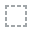
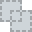
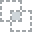
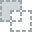
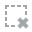
...
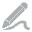
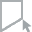
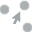
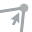
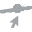

In [ ]:
plot_correlation(dados_limpos_features, "LEUKOCYTES_MEAN", "NEUTROPHILES_MEAN") #Plotando a correlação entre as variáveis


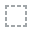
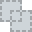
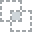
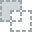
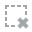
...
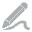
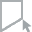
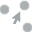
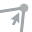
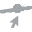

In [ ]:
plot_correlation(dados_limpos_features, "HEMATOCRITE_MEAN", "HEMOGLOBIN_MEAN") #Plotando a correlação entre as variáveis

De acordo com a aproximação das variáveis na tendência de construção de uma reta linear, é possível determinar uma correlação (forte) entre as variáveis analisadas. Quiçá devam ser descartadas do dataset para fins de análises. Iremos analisar a correlação de Pearson entre elas:

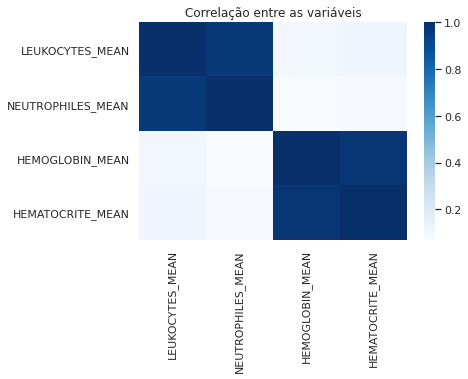

In [ ]:
# correlação entre as variáveis selecionadas a partir de um heatmap do seaborn
heatmap = sns.heatmap(dados_limpos_features[['LEUKOCYTES_MEAN', 'NEUTROPHILES_MEAN', 'HEMOGLOBIN_MEAN', 'HEMATOCRITE_MEAN']].corr(), cmap='Blues', fmt = '.2f')
plt.title('Correlação entre as variáveis');

**Como interpretar o gráfico acima?**

A fim de entender o gráfico acima, estarei elucidando o que significa cada intervalo:

![](https://i.ibb.co/BGjBvwz/Apresenta-o-sem-t-tulo-21.jpg)

É possível concluir que as colunas analisadas possuem uma forte correlação. Este artifício pode interferir intrinsecamente no desempenho dos modelos a serem analisados.

### **3.1.3 E como essas variáveis analisadas estão distribuídas?**

Utilizarei boxplot. Deixo um breve resumo sobre o que ele é:

![](https://res.cloudinary.com/practicaldev/image/fetch/s--RLvfX5qg--/c_limit%2Cf_auto%2Cfl_progressive%2Cq_auto%2Cw_880/https://miro.medium.com/max/1024/0%2ATmxBdUzCLOmZu6zB.png)

*Fonte: https://dev.to/giselyalves13/visualizacao-de-dados-com-seaborn-2892*

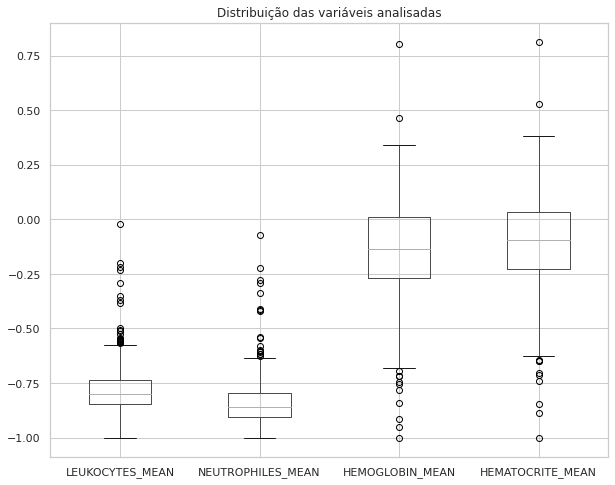

In [ ]:
plt.figure(figsize=(10,8))
dados_limpos_features[['LEUKOCYTES_MEAN', 'NEUTROPHILES_MEAN', 'HEMOGLOBIN_MEAN', 'HEMATOCRITE_MEAN']].boxplot().set_title("Distribuição das variáveis analisadas");

De fato, a partir dos boxplots é visível que essas variáveis são bem parecidas e possuem uma distribuição correlacionada. 

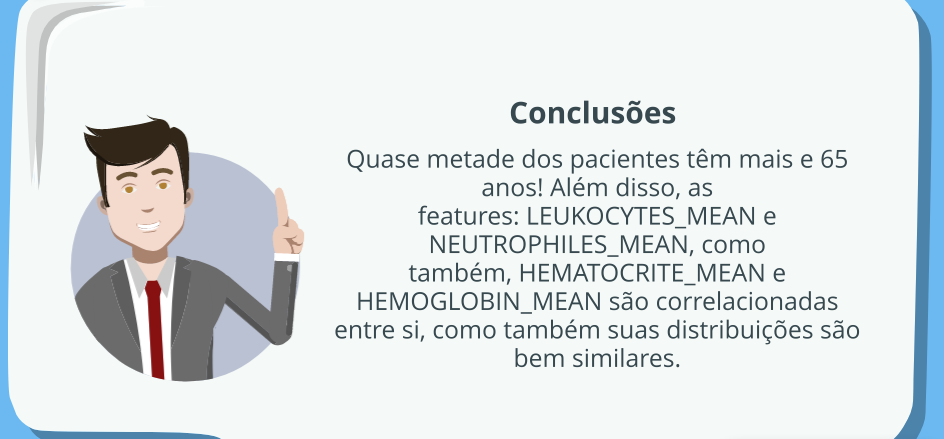

## **3.2 Dados selecionados pelo Sírio-Libanês**


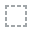
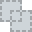
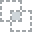
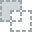
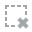
...
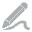
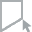
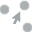
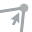
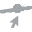

In [ ]:
plot(features_sirio)

A partir dos dados com as colunas selecionadas pelo Sírio-Libanês, temos distribuições parecidas com as plotadas anterioremente. Existem distribuições similares, como as distribuições das doenças (1 ou 0).  

A fim de analisar mais profundamente, veremos as correlações entre as variáveis:

In [ ]:
#plot_correlation(features_sirio ) Para rodar a imagem a seguir, foi executado o colando e selecionado 'Pearson'

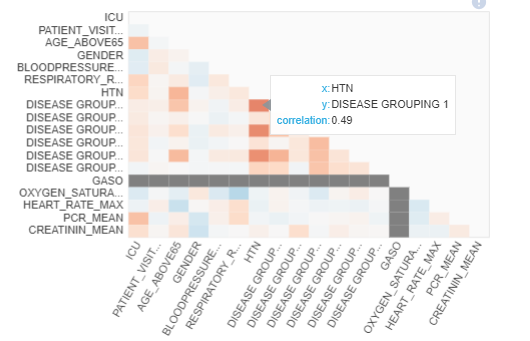

Nestes dados, por exemplo, a maior correlação é entre a coluna HTN e a Doença grupo 1. Apesar de ser a maior, é considerável para as análises seguintes.

## **3.3 Seleção das variáveis para o modelo**

### **3.3.1 Concatenação das bases**

A fim de proporcionar uma qualidade melhor nas análises do modelo, será necessária a seleção das variáveis úteis para o dataframe. Partindo das premissas adquiridas anteriormente, podemos selecionar e tratar melhor a base.

Com intuito de unir algumas informações selecionadas pelo Sírio-Libanês, estarei concatenando as duas bases trabalhadas (pois possuem os mesmos pacientes) e extraindo as informações em comum entre as duas, para por fim concatenar apenas as úteis:

In [ ]:
dados_concatenados = pd.merge(dados_limpos_features, features_sirio, how = 'left', left_on=['PATIENT_VISIT_IDENTIFIER'], right_on = ['PATIENT_VISIT_IDENTIFIER'])

colunas_repetidas = []

for columns in dados_concatenados.columns:
  if columns.endswith('y'):
    colunas_repetidas.append(columns)

colunas_repetidas

['ICU_y',
 'WINDOW_y',
 'AGE_ABOVE65_y',
 'GENDER_y',
 'HTN_y',
 'DISEASE GROUPING 1_y',
 'DISEASE GROUPING 2_y',
 'DISEASE GROUPING 3_y',
 'DISEASE GROUPING 4_y',
 'DISEASE GROUPING 5_y',
 'DISEASE GROUPING 6_y',
 'PCR_MEAN_y',
 'CREATININ_MEAN_y']

Deste modo, podemos selecionar quais colunas são "repetidas" na nossa base de dados a fim de evitar correlações e malefícios ao modelo.

In [ ]:
dados_concatenados = dados_concatenados.drop(colunas_repetidas,axis=1)
dados_concatenados.columns = dados_concatenados.columns.str.replace("_x", "")
dados_concatenados.head()

,PATIENT_VISIT_IDENTIFIER,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMATOCRITE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LEUKOCYTES_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SAT02_VENOUS_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,WINDOW,ICU,BLOODPRESSURE_ARTERIAL_MEAN,RESPIRATORY_RATE_MAX,GASO,OXYGEN_SATURATION_MIN,HEART_RATE_MAX
0,0,1,5,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.183673,-0.868365,-0.742004,-0.945093,-0.891993,0.090147,0.109756,-0.932246,1.000000,-0.835844,-0.914938,-0.868747,-0.170732,-0.704142,-0.77931,-0.754601,-0.875236,0.234043,0.363636,-0.540721,-0.518519,0.939394,0.345679,-0.028571,-0.997201,-0.990854,-0.825613,-0.836145,-0.994912,0.086420,-0.230769,-0.283019,-0.593220,-0.285714,0.736842,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,1,-0.019310,-0.636364,1,0.898990,-0.432836
1,2,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.912243,-0.742004,-0.958528,-0.780261,0.144654,0.158537,-0.959849,1.000000,-0.382773,-0.908714,-0.412965,-0.170732,-0.704142,-0.77931,-0.754601,-0.939887,0.234043,0.363636,-0.399199,-0.703704,0.939394,0.345679,0.085714,-0.995428,-0.986662,-0.846633,-0.836145,-0.978029,-0.489712,-0.685470,-0.048218,-0.645951,0.357143,0.935673,-0.515528,-0.351328,-0.747001,-0.756272,-1.000000,-0.961262,0-2,1,-0.554965,-0.575758,1,0.959596,0.000000
2,3,0,3,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,-0.263158,-1.0,-1.0,-0.317073,-0.317073,-0.972789,-1.0,0.326531,-0.968861,-0.194030,-0.316589,-0.891993,-0.203354,-0.219512,-0.959849,-0.828421,-0.729239,-0.836100,-0.784714,-0.170732,-0.633136,-0.77931,-0.779141,-0.503592,0.234043,0.363636,-0.564753,-0.777778,0.939394,0.580247,0.200000,-0.989549,-0.956555,-0.846633,-0.937349,-0.978029,0.012346,-0.369231,-0.528302,-0.457627,-0.285714,0.684211,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0-2,0,-0.114846,-0.515152,1,0.878788,-0.626866
3,4,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.935113,-1.0,0.357143,-0.913659,-0.829424,-0.938084,-0.851024,0.358491,0.304878,-0.959849,1.000000,-0.702202,-0.641079,-0.812725,-0.170732,-0.704142,-0.77931,-0.754601,-0.990926,0.234043,0.363636,-0.457944,-0.592593,0.939394,0.345679,0.142857,-0.998507,-0.991235,-0.846633,-0.903614,-1.000000,0.333333,-0.153846,0.160377,-0.593220,0.285714,0.868421,-1.000000,-0.883669,-0.956805,-0.870968,-0.953536,-0.980333,0-2,0,0.170940,-0.575758,1,0.939394,-0.044776
4,5,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.891012,-0.742004,-0.958528,-0.891993,0.291405,0.243902,-0.959849,1.000000,-0.706450,-0.340249,-0.846339,-0.170732,-0.704142,-0.77931,-0.754601,-0.997732,0.234043,0.363636,-0.292390,-0.666667,0.939394,0.345679,0.085714,-0.997947,-0.988948,-0.846633,-0.884337,-1.000000,-0.037037,-0.538462,-0.537736,-0.525424,-0.196429,0.815789,-0.860870,-0.714460,-0.986481,-1.000000,-0.975891,-0.980129,0-2,0,-0.204179,-0.575758,1,0.919192,-0.626866


In [ ]:
linhas, colunas = dados_concatenados.shape
print(f'O dataset concatenado possui {linhas} pacientes e {colunas} features. O dataset original possuía {dados.shape[1]} colunas. Redução de {dados.shape[1] - colunas} features.')

O dataset concatenado possui 352 pacientes e 68 features. O dataset original possuía 231 colunas. Redução de 163 features.


### **3.3.2 Tratando variáveis variáveis**

É visível que, no dataset acima, existem colunas que contém valores únicos, como WINDOW e GASO. Deverá, portanto, exlcuir as mesmas, pois não há contribuição para o modelo.

In [ ]:
dados_concatenados = dados_concatenados.drop(['WINDOW', 'GASO'], axis=1)
colunas = dados_concatenados.shape[1]

print(f'O dataset possui {colunas} colunas agora.')

O dataset possui 66 colunas agora.


Como visto na seção anterior, há colunas com alta correlação 'LEUKOCYTES_MEAN' e 'NEUTROPHILES_MEAN', 'HEMOGLOBIN_MEAN' e 'HEMATOCRITE_MEAN'. Portanto, devemos excluir uma de cada par correlacionado:

In [ ]:
dados_concatenados = dados_concatenados.drop(['HEMATOCRITE_MEAN', 'LEUKOCYTES_MEAN'], axis = 1).set_index('PATIENT_VISIT_IDENTIFIER')
dados_concatenados.head()

,AGE_ABOVE65,AGE_PERCENTIL,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SAT02_VENOUS_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU,BLOODPRESSURE_ARTERIAL_MEAN,RESPIRATORY_RATE_MAX,OXYGEN_SATURATION_MIN,HEART_RATE_MAX
PATIENT_VISIT_IDENTIFIER,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1,5,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.183673,-0.868365,-0.742004,-0.945093,-0.891993,0.109756,-0.932246,1.000000,-0.914938,-0.868747,-0.170732,-0.704142,-0.77931,-0.754601,-0.875236,0.234043,0.363636,-0.540721,-0.518519,0.939394,0.345679,-0.028571,-0.997201,-0.990854,-0.825613,-0.836145,-0.994912,0.086420,-0.230769,-0.283019,-0.593220,-0.285714,0.736842,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1,-0.019310,-0.636364,0.898990,-0.432836
2,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.912243,-0.742004,-0.958528,-0.780261,0.158537,-0.959849,1.000000,-0.908714,-0.412965,-0.170732,-0.704142,-0.77931,-0.754601,-0.939887,0.234043,0.363636,-0.399199,-0.703704,0.939394,0.345679,0.085714,-0.995428,-0.986662,-0.846633,-0.836145,-0.978029,-0.489712,-0.685470,-0.048218,-0.645951,0.357143,0.935673,-0.515528,-0.351328,-0.747001,-0.756272,-1.000000,-0.961262,1,-0.554965,-0.575758,0.959596,0.000000
3,0,3,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,-0.263158,-1.0,-1.0,-0.317073,-0.317073,-0.972789,-1.0,0.326531,-0.968861,-0.194030,-0.316589,-0.891993,-0.219512,-0.959849,-0.828421,-0.836100,-0.784714,-0.170732,-0.633136,-0.77931,-0.779141,-0.503592,0.234043,0.363636,-0.564753,-0.777778,0.939394,0.580247,0.200000,-0.989549,-0.956555,-0.846633,-0.937349,-0.978029,0.012346,-0.369231,-0.528302,-0.457627,-0.285714,0.684211,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0,-0.114846,-0.515152,0.878788,-0.626866
4,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.935113,-1.0,0.357143,-0.913659,-0.829424,-0.938084,-0.851024,0.304878,-0.959849,1.000000,-0.641079,-0.812725,-0.170732,-0.704142,-0.77931,-0.754601,-0.990926,0.234043,0.363636,-0.457944,-0.592593,0.939394,0.345679,0.142857,-0.998507,-0.991235,-0.846633,-0.903614,-1.000000,0.333333,-0.153846,0.160377,-0.593220,0.285714,0.868421,-1.000000,-0.883669,-0.956805,-0.870968,-0.953536,-0.980333,0,0.170940,-0.575758,0.939394,-0.044776
5,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.891012,-0.742004,-0.958528,-0.891993,0.243902,-0.959849,1.000000,-0.340249,-0.846339,-0.170732,-0.704142,-0.77931,-0.754601,-0.997732,0.234043,0.363636,-0.292390,-0.666667,0.939394,0.345679,0.085714,-0.997947,-0.988948,-0.846633,-0.884337,-1.000000,-0.037037,-0.538462,-0.537736,-0.525424,-0.196429,0.815789,-0.860870,-0.714460,-0.986481,-1.000000,-0.975891,-0.980129,0,-0.204179,-0.575758,0.919192,-0.626866


Além dessas correlações, devemos avaliar se há mais variáveis que estão correlacionadas entre si, Portanto, irei plocar um gráfico que demonstra a correlação de Pearson, já vista anteriormente:

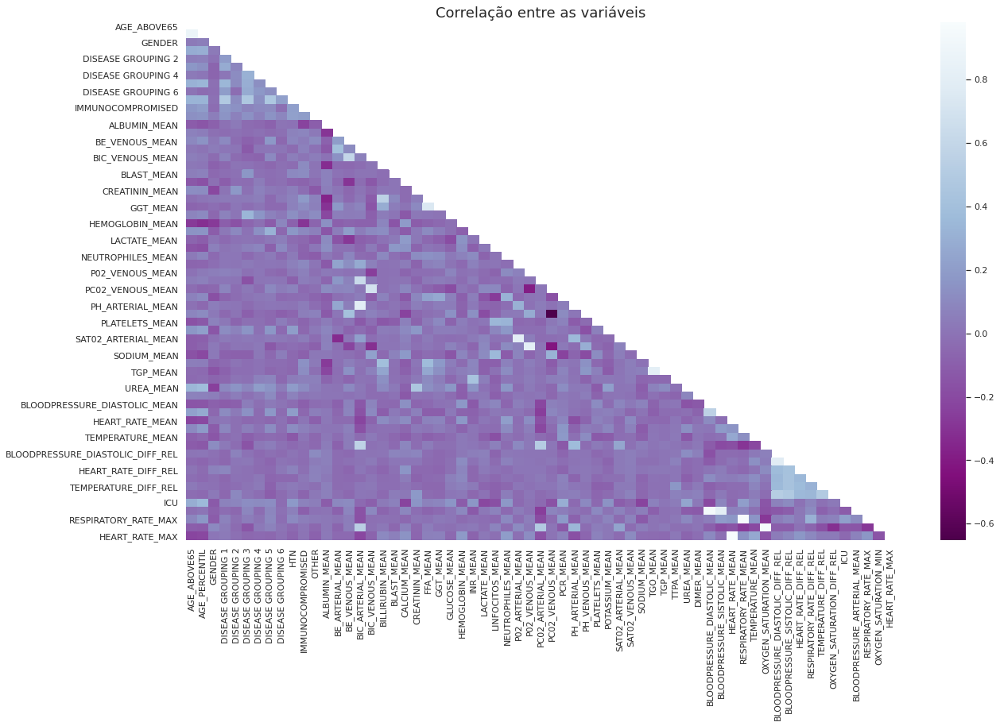

In [ ]:
plt.figure(figsize=(20,12))
x = np.triu(np.ones_like(dados_concatenados.corr(), dtype=np.bool)) #matriz para evitar a "diagonal principal à direita"
heatmap = sns.heatmap(dados_concatenados.corr(), mask = x, cmap='BuPu_r', fmt = '.2f')
plt.title('Correlação entre as variáveis', fontsize = 18);

Há certos pontos mais claros/azuis que demonstram haver, ainda, correlações fortes entre algumas variáveis. 

- Conforme visto anteriormente, na correlação de Pearson, quanto maior é a correlação em módulo, maior é a correlação. Portanto, quando |p| > 0,80 é uma correlação forte. 

Partindo disso, irei excluir as variáveis que possuem essa característica:

In [ ]:
alta_corr = 0.81 #determinando a correlação
matrix_corr = dados_concatenados.corr().abs()
matrix_upper = matrix_corr.where(np.triu(np.ones(matrix_corr.shape), k=1).astype(np.bool))
excluir = [coluna for coluna in matrix_upper.columns if any(matrix_upper[coluna] > alta_corr)] #determinando as colunas que devem ser excluídas

dados_concatenados = dados_concatenados.drop(excluir, axis=1)
dados_concatenados.head()

,AGE_ABOVE65,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU
PATIENT_VISIT_IDENTIFIER,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1,0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.183673,-0.868365,-0.742004,-0.945093,-0.891993,0.109756,-0.932246,1.000000,-0.914938,-0.868747,-0.170732,-0.704142,-0.77931,-0.754601,-0.875236,0.234043,0.363636,-0.540721,-0.518519,0.939394,-0.028571,-0.997201,-0.990854,-0.825613,-0.836145,-0.994912,0.086420,-0.230769,-0.283019,-0.593220,-0.285714,0.736842,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1
2,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.912243,-0.742004,-0.958528,-0.780261,0.158537,-0.959849,1.000000,-0.908714,-0.412965,-0.170732,-0.704142,-0.77931,-0.754601,-0.939887,0.234043,0.363636,-0.399199,-0.703704,0.939394,0.085714,-0.995428,-0.986662,-0.846633,-0.836145,-0.978029,-0.489712,-0.685470,-0.048218,-0.645951,0.357143,0.935673,-0.515528,-0.351328,-0.747001,-0.756272,-1.000000,-0.961262,1
3,0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,-0.263158,-1.0,-1.0,-0.317073,-0.317073,-0.972789,-1.0,0.326531,-0.968861,-0.194030,-0.316589,-0.891993,-0.219512,-0.959849,-0.828421,-0.836100,-0.784714,-0.170732,-0.633136,-0.77931,-0.779141,-0.503592,0.234043,0.363636,-0.564753,-0.777778,0.939394,0.200000,-0.989549,-0.956555,-0.846633,-0.937349,-0.978029,0.012346,-0.369231,-0.528302,-0.457627,-0.285714,0.684211,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0
4,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.935113,-1.0,0.357143,-0.913659,-0.829424,-0.938084,-0.851024,0.304878,-0.959849,1.000000,-0.641079,-0.812725,-0.170732,-0.704142,-0.77931,-0.754601,-0.990926,0.234043,0.363636,-0.457944,-0.592593,0.939394,0.142857,-0.998507,-0.991235,-0.846633,-0.903614,-1.000000,0.333333,-0.153846,0.160377,-0.593220,0.285714,0.868421,-1.000000,-0.883669,-0.956805,-0.870968,-0.953536,-0.980333,0
5,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.0,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.891012,-0.742004,-0.958528,-0.891993,0.243902,-0.959849,1.000000,-0.340249,-0.846339,-0.170732,-0.704142,-0.77931,-0.754601,-0.997732,0.234043,0.363636,-0.292390,-0.666667,0.939394,0.085714,-0.997947,-0.988948,-0.846633,-0.884337,-1.000000,-0.037037,-0.538462,-0.537736,-0.525424,-0.196429,0.815789,-0.860870,-0.714460,-0.986481,-1.000000,-0.975891,-0.980129,0


In [ ]:
linhas, colunas = dados_concatenados.shape #extraindo o número de linhas e colunas do dataset atual
print(f'O dataset possui {linhas} linhas com {colunas} features.')

O dataset possui 352 linhas com 57 features.


Partindo desse pressuposto, os dados estão mais reduzidos e mais aptos para as análises seguintes.

**Verificando se há alguma anomalia nos dados**


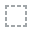
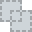
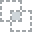
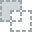
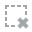
...
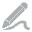
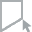
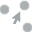
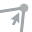
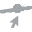

In [ ]:
plot_missing(dados_concatenados)

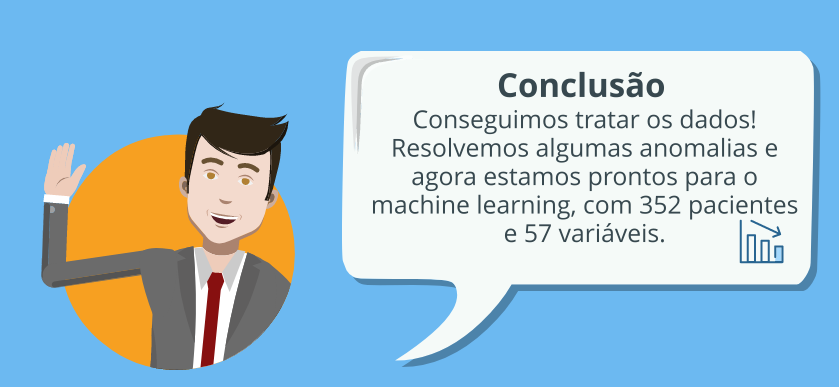

#**4. Machine Learning**

Após a seleção dos dados de acordo com todas as análises, a base está pronta para entrar em produção sob um modelo de Machine Learning. 

- **Mas afinal, o que é Machine Learning?**

De modo conciso e direto, o próprio Machine Learningé o estudo de algoritmos que melhoram automaticamente através da experiência, isto é, conforme o modelo vai recebendo dados e aprendendo, assim como um recém-nascido. Os algoritmos  constroem um modelo baseado em dados de amostra, conhecidos como "dados de treinamento", a fim de fazer previsões ou decisões sem serem explicitamente programados para fazê-lo. De modo geral, modelos de machine learning são usados em uma ampla variedade de aplicações, como visão computacional, filtragem de e-mails ou até mesmo o caso que estamos tratanto!

![](https://www.ceralytics.com/wp-content/uploads/2019/08/machine-learning-featured.jpg)

Uma vez que um modelo é treinado com os dados submetidos à ele, o mesmo vai aperfeiçoando sua "inteligência de percepção", realizando uma predição para algo determinado, seja uma categoria ou até um valor. 

Agora que você já sabe um pouco sobre Machine Learning, iremos prosseguir com as análises. Para construção dos modelos e das análises, estarei utilizando da biblioteca PyCaret com fins de comparação e interpretação dos algoritmos.

O nosso objetivo é predizer, com base nas características obtidas dos pacientes, se ele vai ou não para UTI (coluna ICU = 1). Baseado nessa informação, já podemos determinar que o modelo será de classificação, e não de regressão. Portanto, além dos modelos serem diferentes, as métricas serão expostas de maneira mais instuitiva e categorica.

## **4.1 O que é o PyCaret?**

![](https://pycaret.org/wp-content/uploads/2020/03/Divi93_43.png)

PyCaret é uma biblioteca que possibilita o automachinelearning (AutoML), de código aberto, onde para desenvolver um modelo de aprendizagem de máquinas são necessárias poucas linhas de código. Sua capacidade é astronômica! A exigência é da versão do Python 3.6 ou superior e ter uma conexão com a internet.

A documentação pode ser encontrada aqui: https://pycaret.org/

## **4.2 O modelo de classificação**

A classificação binária é uma técnica de aprendizado de máquina supervisionada em que o objetivo é prever rótulos de classe categóricos que são discretos e não corrigidos. Um exemplo é a classificação, por meio de alguns parâmetros, se um e-mail é spam ou não.
- O nosso objetivo é predizer, com base nas características obtidas dos pacientes, se ele vai ou não para UTI (coluna ICU = 1). Baseado nessa informação, já podemos determinar que o modelo será de classificação, e não de regressão. Portanto, além dos modelos serem diferentes, as métricas serão expostas de maneira mais instuitiva e categorica.

Sobre a classificação, recomendo que leia um pouco sobre neste artigo: https://medium.com/@categitau/in-one-of-my-previous-posts-i-introduced-machine-learning-and-talked-about-the-two-most-common-c1ac6e18df16

- De modo geral, o módulo de classificação PyCaret pode ser usado para problemas de classificação binários ou multiclasse. Possui mais de **18 algoritmos e 14 gráficos** para analisar o desempenho dos modelos, facilitando na interpretação e na comparação dos dados, fator esse que justifica a escolha da biblioteca.

## **4.3 Configurando e separando os dados**

O próprio módulo do PyCaret realiza a separação entre treino e teste. Mas por quê precisa disso? De modo geral, as validações se dão em dados "separados" para que o modelo não seja **enviesado** e se comporte de maneira a demonstrar um **overfitting**. Para análise do comportamento posterior do modelo, estarei separando os dados para validação:

In [ ]:
from sklearn.model_selection import train_test_split

train, validation = train_test_split(dados_concatenados, test_size=0.2,
                                     random_state=1234)

print('Dados para Treino: ' + str(train.shape))
print('Dados para Teste e Predição: ' + str(validation.shape))

Dados para Treino: (281, 57)
Dados para Teste e Predição: (71, 57)


In [ ]:
train.head()

,AGE_ABOVE65,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU
PATIENT_VISIT_IDENTIFIER,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
125,1,0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.605263,-1.0,-0.643979,-0.317073,-0.219512,-0.964417,-1.0,0.102041,-0.874027,-0.722814,-0.914720,-0.891993,-0.451220,-0.656211,1.0,-0.800830,-0.831132,-0.170732,-0.822485,-0.77931,-0.815951,-0.658601,0.234043,0.606061,-0.246996,-0.888889,0.939394,-0.200000,-0.994028,-0.995427,-0.749319,-0.802410,-0.920056,0.037037,-0.230769,-0.471698,-0.254237,0.250000,0.684211,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1
155,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.885350,-0.742004,-0.958528,-0.891993,-0.012195,-0.959849,1.0,-0.881743,-0.679472,-0.170732,-0.704142,-0.77931,-0.754601,-0.494518,0.234043,0.363636,-0.802403,-0.518519,0.939394,-0.257143,-0.998507,-0.996189,-0.846633,-0.879518,-0.949350,-0.238683,-0.307692,-0.132075,-0.401130,0.702381,0.719298,-0.704088,-0.663471,-0.969813,-0.268817,-0.644575,-0.959202,1
146,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.142857,-0.926398,-0.742004,-0.958528,-0.776536,-0.268293,-0.882058,1.0,-0.892116,-0.766307,-0.170732,-0.704142,-0.77931,-0.754601,-0.757656,0.234043,0.363636,-0.583445,-0.629630,0.939394,-0.085714,-0.991789,-0.982851,-0.694823,-0.898795,-0.978029,0.333333,-0.230769,-0.433962,-0.457627,-0.071429,0.824561,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-0.980232,0
328,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.408163,-0.902335,-0.742004,-0.958528,-0.891993,0.207317,-0.959849,1.0,-0.504149,-0.865946,-0.170732,-0.704142,-0.77931,-0.754601,-0.975425,0.234043,0.363636,-0.602136,-0.592593,0.939394,-0.028571,-0.994215,-0.979040,-0.846633,-0.879518,-0.978029,0.209877,-0.307692,-0.452830,-0.457627,0.142857,0.842105,-1.000000,-1.000000,-1.000000,-0.884550,-1.000000,-1.000000,0
272,1,0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.924982,-0.742004,-0.958528,-0.891993,0.000000,-0.959849,1.0,-0.695021,-0.945578,-0.170732,-0.704142,-0.77931,-0.754601,-0.988280,0.234043,0.363636,-0.559413,-0.592593,0.939394,-0.142857,-0.996827,-0.984756,-0.846633,-0.845783,-0.995452,0.037037,-0.446154,-0.471698,-0.593220,-0.214286,0.736842,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0


In [ ]:
train['ICU'].value_counts()

0    150
1    131
Name: ICU, dtype: int64

De modo geral, a label não está em disparidade. Não haverá problemas com dados desbalanceados.

In [ ]:
validation.head()

,AGE_ABOVE65,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU
PATIENT_VISIT_IDENTIFIER,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
50,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-0.308901,-0.317073,-0.073171,-0.938950,-1.0,0.000000,-0.933475,-0.742004,-0.958528,-0.891993,-0.060976,-0.959849,-0.897773,-0.738589,-0.614646,-0.170732,0.017751,-0.77931,-0.779141,-0.887335,0.234043,0.666667,-0.484646,-0.555556,0.939394,-0.257143,-0.996454,-0.995808,-0.846633,-0.720482,-0.976101,0.358025,-0.076923,0.169811,-0.254237,0.089286,0.789474,-1.000000,-1.000000,-1.000000,-1.0,-0.929255,-1.000000,0
8,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.081633,-0.868365,-0.742004,-0.990654,-0.891993,-0.012195,-0.959849,-0.952572,-0.724066,-0.851140,-0.170732,-0.704142,-0.77931,-0.754601,-0.798110,0.234043,0.363636,-0.522029,-0.777778,0.939394,-0.600000,-0.998134,-0.997332,-0.846633,-0.874699,-0.978029,-0.185185,-0.630769,-0.320755,-0.593220,0.464286,0.789474,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0
277,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.885350,-0.742004,-0.958528,-0.873371,-0.012195,-0.959849,1.000000,-0.819502,-0.939576,-0.170732,-0.704142,-0.77931,-0.754601,-0.941021,0.234043,0.363636,-0.676903,-0.518519,0.939394,0.142857,-0.995521,-0.984375,-0.846633,-0.884337,-1.000000,0.308642,-0.076923,-0.264151,-0.525424,0.250000,0.894737,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0
244,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.204082,-0.881104,-0.742004,-0.958528,-0.891993,-0.341463,-0.959849,1.000000,-0.838174,-0.873950,-0.170732,-0.704142,-0.77931,-0.754601,-0.774669,0.234043,0.363636,-0.538051,-0.481481,0.939394,0.066667,-0.996081,-0.996189,-0.846633,-0.879518,-0.977335,-0.012346,-0.292308,-0.283019,-0.457627,0.142857,0.842105,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0
100,1,1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.315789,-1.0,-1.000000,-0.317073,-0.365854,-0.989534,-1.0,0.306122,-0.780609,-0.820896,-0.954439,-0.891993,-0.548780,-0.957340,-0.886215,-0.856846,-0.965186,-0.170732,-0.893491,-0.77931,-0.717791,-0.947070,0.234043,0.181818,-0.634179,-0.666667,0.939394,0.066667,-0.988989,-0.981326,-0.798365,-0.802410,-0.989053,-0.629630,-0.553846,-0.811321,-0.525424,-0.107143,0.684211,-0.959079,-0.971184,-0.895824,-1.0,-0.808466,-0.959202,1


In [ ]:
validation['ICU'].value_counts()

0    39
1    32
Name: ICU, dtype: int64

O mesmo ocorre com a validação. Portanto, os dados estão aptos para as avaliações.

## **4.4 Setup dos modelos**

Para inicializar os modelos e o próprio Pycaret, é necessária a execução do comando `setup()`. Quando setup () é executado, o algoritmo de inferência do PyCaret inferirá automaticamente os tipos de dados para todos os recursos com base em certas propriedades. A função setup () inicializa o ambiente em pycaret e cria o pipeline de transformação para preparar os dados para modelagem e implantação.  Leva dois parâmetros obrigatórios: um dataframe do pandas e o nome da coluna de destino, isto é, a coluna que queremos predizer.

### **4.4.1 Simiulação do Setup em seu computador**

Para proceder com o Setup(), caso você queira reproduzir o experimento em sua máquina/seu colab, certifique-se que as bibliotecas iniciais foram instaladas. Além disso, você deverá seguir os passos seguintes:

<a href="https://gifyu.com/image/ZKc3"><img src="https://s4.gifyu.com/images/final_603440e908dedf00363e1f6d_868665.gif" alt="final_603440e908dedf00363e1f6d_868665.gif" border="0" width = "500" /></a>

In [ ]:
setup = setup(data=train, target='ICU', 
              session_id=1405)

,Description,Value
0,session_id,1405
1,Target,ICU
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(281, 57)"
5,Missing Values,False
6,Numeric Features,43
7,Categorical Features,13
8,Ordinal Features,False
9,High Cardinality Features,False


create_model_container: 0
master_model_container: 0
display_container: 1
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='ICU',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strategy...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluster_all', 'passthrough'),
                

Alguns parâmetros do Setup:

- **session_id :**  Neste experimento, o `session_id` é definido como` 1405` para reprodutibilidade posterior. Nessa semente, podemos reproduzir todos os passos obtendo o mesmo resultado. <br/>
<br/>
- **Target Type :**  Binário ou multiclasse. 
<br/>
<br/>
- **Label Encoded :**  Quando a variável de destino é do tipo string (ou seja, 'Sim' ou 'Não') em vez de 1 ou 0, ela codifica automaticamente o rótulo em 1 e 0 e exibe o mapeamento (0: Não, 1: Sim) para referência. Neste experimento, nenhuma codificação de rótulo é necessária, pois a variável de destino é do tipo numérico. <br/>
<br/>
- **Original Data :**  Exibe a forma original do conjunto de dados. Neste experimento (282, 57) significa 281 amostras e 57 recursos, incluindo a coluna de destino. <br/>
<br/>
- **Missing Values :**  Quando houver valores ausentes nos dados originais, isso será mostrado como True. Para este experimento, não há valores ausentes no conjunto de dados.
<br/>
<br/>
- **Numeric Features :**  O número de recursos inferidos como numéricos. Neste conjunto de dados, 43 de 57 recursos são inferidos como numéricos. <br/>
<br/>
- **Categorical Features :**  O número de recursos inferidos como categóricos. Neste conjunto de dados, 13 de 57 recursos são inferidos como categóricos. <br/>
<br/>
- **Transformed Train Set :**  Exibe a forma do conjunto de treinamento transformado.  <br/>
<br/>
- **Transformed Test Set :**  Exibe a forma do conjunto de teste / retenção transformado. <br/>


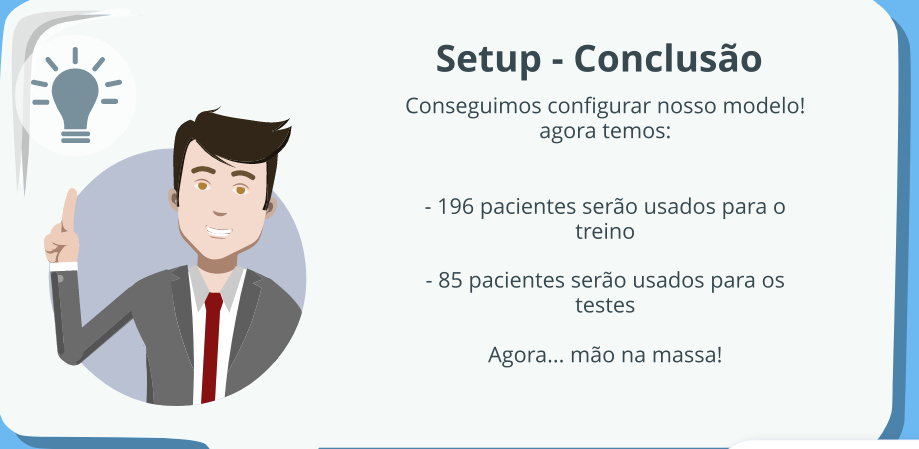

### **4.4.2 Há algumas possíveis configurações para setar no Pycaret. Caso necessário, será feita a alteração:**

De modo geral, o **Feature Selection** é um processo  usado para selecionar recursos no conjunto de dados que mais contribuem na previsão da variável de destino. Trabalhar com recursos selecionados em vez de todos os recursos reduz o risco de sobreajuste, melhora a precisão e diminui o tempo de treinamento. No PyCaret, isso pode ser alcançado usando o parâmetro feature_selection . Ele usa uma combinação de várias técnicas de seleção de recursos supervisionados para selecionar o subconjunto de recursos que são mais importantes para a modelagem.  Portanto, além das minhas análises, o Pycaret analisa novamente os dados e seleciona as variáveis mais importantes para as análises.

Além disso, o **Remove Multicollinearity**  é um fenômeno no qual uma variável de recurso no conjunto de dados é altamente linearmente correlacionada com outra variável de recurso no mesmo conjunto de dados. A multicolinearidade aumenta a variância dos coeficientes, tornando-os instáveis ​​e ruidosos para os modelos lineares. Uma dessas maneiras de lidar com a Multicolinearidade é eliminar uma das duas características que são altamente correlacionadas entre si.

Ademais, referente ao **Ignore Low Variance**, às vezes, um conjunto de dados pode ter um recurso categórico  com vários níveis, em que a distribuição de tais níveis é distorcida e um nível pode dominar os outros níveis. Isso significa que não há muita variação nas informações fornecidas por esse recurso. Para um modelo de ML, esse recurso pode não adicionar muitas informações e, portanto, pode ser ignorado para modelagem. As duas condições abaixo devem ser atendidas para que um recurso seja considerado um recurso de baixa variação.

- Contagem de valores únicos em um recurso / tamanho de amostra < 10%
- Contagem do valor mais comum / Contagem do segundo valor mais comum> 20 vezes.



## **4.5 Modelos em produção**

Nesta seção, iniciaremos a comparação dos modelos. Comparar todos os modelos para avaliar o desempenho é o ponto de partida recomendado para modelagem depois que a configuração for concluída. 

A declaração `fold = 10` significa que as métricas estão sendo baseadas em dez camadas de cross-validation.  A validação cruzada nos ajuda a não cometer o erro de usar os dados de teste para avaliar e tentar melhorar o modelo, além de ajudar a criar um intervalo de quão bom o modelo é.

![](https://ethen8181.github.io/machine-learning/model_selection/img/kfolds.png)

*Fonte: https://ethen8181.github.io/machine-learning/model_selection/model_selection.html*

O objetivo da validação cruzada é testar a capacidade do modelo de prever novos dados que não foram usados para estimá-los, a fim de sinalizar problemas como o excesso de adequação ou viés de seleção e dar uma visão de como o modelo se generalizará para um conjunto de dados independente (ou seja, um conjunto de dados desconhecido, por exemplo, a partir de um problema real). *Referência: https://en.wikipedia.org/wiki/Cross-validation_(statistics)*

In [ ]:
best_model = compare_models(fold = 10)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.7608,0.7842,0.7733,0.7441,0.7458,0.5210,0.5380,0.466
rf,Random Forest Classifier,0.7545,0.8091,0.7289,0.7493,0.7309,0.5051,0.5148,0.480
gbc,Gradient Boosting Classifier,0.7495,0.7995,0.7311,0.7539,0.7312,0.4965,0.5080,0.137
ada,Ada Boost Classifier,0.7195,0.7600,0.7211,0.6925,0.7034,0.4376,0.4425,0.116
lightgbm,Light Gradient Boosting Machine,0.7192,0.7840,0.7411,0.6914,0.7098,0.4378,0.4463,0.049
lda,Linear Discriminant Analysis,0.7142,0.7302,0.6100,0.7403,0.6615,0.4198,0.4329,0.022
lr,Logistic Regression,0.7095,0.7600,0.6544,0.7133,0.6756,0.4143,0.4219,0.321
ridge,Ridge Classifier,0.7045,0.0000,0.6111,0.7200,0.6484,0.4007,0.4146,0.019
svm,SVM - Linear Kernel,0.6897,0.0000,0.6611,0.7290,0.6359,0.3806,0.4291,0.020
knn,K Neighbors Classifier,0.6474,0.7046,0.5000,0.6629,0.5596,0.2789,0.2896,0.118


create_model_container: 13
master_model_container: 13
display_container: 2
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=1405, verbose=0,
                     warm_start=False)
compare_models() succesfully completed......................................


De modo geral, foram testados 15 modelos e foi arquivada as métricas de cada um na tabela acima. Entretanto, é nessária a determinação do melhor modelo baseada nas métricas.

## **4.6 O que siginificam as métricas?**

- **Acurácia**
A métrica mais usada para mensurar o desempenho de classificadores é a acurácia. Ela é bem direta e pode ser usada quando se deseja ter uma noção geral de quão bem seu modelo está funcionando. Ela é calculada pela seguinte fórmula:

![](https://miro.medium.com/max/176/1*PhfzgE8VhtJ1DMc23SJq7Q.png)

Um dos maiores problemas ao usar a acurácia é a falta de flexibilidade para dar ênfase no tipo de projeto que se está realizando, e acabamos por algumas vezes fazendo uma análise muito superficial. A matriz de confusão nos permite analisar o desempenho do nosso modelo de forma mais cuidadosa:

![](https://glassboxmedicine.files.wordpress.com/2019/02/confusion-matrix.png)

1. True Positives (TP): modelo prediz corretamente a classe positiva ‘1’;
2. False Positives (FP): modelo prediz incorretamente a classe positiva ‘1’;
3. True Negatives (TN): modelo prediz corretamente a classe negativa ‘0’;
4. False Negatives (FN): modelo prediz incorretamente a classe negativa ‘0’;

- **Recall**
Mede uma proporção dos valores que são de fato positivos e que foram preditos corretamente. É uma proporção entre os positivos verdadeiros (TP) e os falsos negativos (FN), conforme apresentado na fórmula.

![](https://miro.medium.com/max/500/1*jfKAlKknD_FRlmRj0JbSZA.jpeg)

- **Precision (Prec.)**
Mede a proporção de predições positivas que estão corretas, ou seja, quão bem o modelo predisse os valores positivos.
É uma proporção entre os positivos verdadeiros (TP) e os falso positivos (FP), conforme apresentado na fórmula.

![](https://miro.medium.com/max/500/1*STWraAVtB8QIIkUe4IbrvQ.jpeg)

- **F1**
É uma média harmônica entre a precisão e o recall. O f1-score será alto quando ambas as métricas forem altas e similares, ou seja, o f1-score é maior quando há um “meio termo” entre precisão e recall.

- **AUC**
É simplesmente a área sob a curva ROC, como indicado a seguir:

![](https://miro.medium.com/max/700/0*aIjep8bY0SKCp5Ba.png)

Podemos compreender esse indicador como a habilidade do modelo de categorizar corretamente os dados, com valor máximo em 1 e mínimo em 0.

![](https://miro.medium.com/max/345/0*fJJ3wksk9UJj_vF_.png)

## **4.7 Criando modelos**

A função create_model() é a função mais granular do PyCaret e muitas vezes é a base por trás da maioria das funcionalidades do PyCaret. Como o nome sugere, esta função treina e avalia um modelo usando validação cruzada que pode ser definida com o parâmetro fold. Vamos criar para os "três melhores modelos": Extra Trees Classifier, Random Forest Classifier e Gradient Boosting Classifier.

In [ ]:
print(best_model) #qual foi o melhor modelo de acordo com a seção anterior

ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=1405, verbose=0,
                     warm_start=False)


In [ ]:
models()

gpu_param set to False
Wrong xgboost version. Expected xgboost>=1.1.0, got xgboost==(0, 90)
Couldn't import catboost.CatBoostClassifier


,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


### **4.7.1 Extra Trees Classifier**

In [ ]:
et = create_model('et', fold = 10)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8000,0.9040,1.0000,0.6923,0.8182,0.6117,0.6637
1,0.7000,0.7475,0.5556,0.7143,0.6250,0.3814,0.3898
2,0.7500,0.8485,0.5556,0.8333,0.6667,0.4792,0.5044
3,0.6000,0.6162,0.6667,0.5455,0.6000,0.2079,0.2121
4,0.7500,0.6600,0.6000,0.8571,0.7059,0.5000,0.5241
5,0.8500,0.8050,0.8000,0.8889,0.8421,0.7000,0.7035
6,0.6842,0.7222,0.7778,0.6364,0.7000,0.3736,0.3820
7,0.7895,0.8056,0.8889,0.7273,0.8000,0.5824,0.5955
8,0.7895,0.8556,0.8889,0.7273,0.8000,0.5824,0.5955
9,0.8947,0.8778,1.0000,0.8182,0.9000,0.7912,0.8090


create_model_container: 14
master_model_container: 14
display_container: 3
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_impurity_split=None,
                     min_samples_leaf=1, min_samples_split=2,
                     min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                     oob_score=False, random_state=1405, verbose=0,
                     warm_start=False)
create_model() succesfully completed......................................


In [ ]:
dicionario_metricas_et = {
    'Accuracy': {'Média': 0.7608, 'Desvio Padrão': 0.0805},
    'AUC': {'Média': 0.7842, 'Desvio Padrão': 0.0906},
    'Recall':  {'Média': 0.7733,  'Desvio Padrão':  0.1632},
    'Precision': {'Média': 0.7441,  'Desvio Padrão': 0.1012},
    'F1': {'Média': 0.7458, 'Desvio Padrão': 0.0949},
    'Kappa': {'Média': 0.5210, 'Desvio Padrão': 0.1619},
    'MCC': {'Média': 0.5380, 'Desvio Padrão': 0.1665}
}

### **4.7.2 Gradient Boosting Classifier**

In [ ]:
gbc = create_model('gbc', fold = 10)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9500,0.9596,1.0000,0.9000,0.9474,0.9000,0.9045
1,0.8000,0.8182,0.5556,1.0000,0.7143,0.5789,0.6383
2,0.9000,0.8384,1.0000,0.8182,0.9000,0.8020,0.8182
3,0.6500,0.7071,0.5556,0.6250,0.5882,0.2857,0.2872
4,0.5500,0.6700,0.5000,0.5556,0.5263,0.1000,0.1005
5,0.7500,0.7800,0.7000,0.7778,0.7368,0.5000,0.5025
6,0.5263,0.6222,0.6667,0.5000,0.5714,0.0656,0.0690
7,0.7895,0.8556,0.8889,0.7273,0.8000,0.5824,0.5955
8,0.7895,0.8556,0.6667,0.8571,0.7500,0.5730,0.5866
9,0.7895,0.8889,0.7778,0.7778,0.7778,0.5778,0.5778


create_model_container: 15
master_model_container: 15
display_container: 4
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=1405, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
create_model() succesfully completed......................................


In [ ]:
dicionario_metricas_gbc = {
    'Accuracy': {'Média': 0.7495, 'Desvio Padrão': 0.1303},
    'AUC': {'Média': 0.7995, 'Desvio Padrão': 0.0994},
    'Recall':  {'Média': 0.7311,  'Desvio Padrão':  0.1720},
    'Precision': {'Média': 0.7539,  'Desvio Padrão': 0.1480},
    'F1': {'Média': 0.7312, 'Desvio Padrão': 0.1307},
    'Kappa': {'Média': 0.4965, 'Desvio Padrão': 0.2589},
    'MCC': {'Média': 0.5080, 'Desvio Padrão': 0.2639}
}

### **4.7.3 Random Forest Classifier**

In [ ]:
rf = create_model('rf', fold = 10)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9500,0.9747,1.0000,0.9000,0.9474,0.9000,0.9045
1,0.7500,0.7323,0.5556,0.8333,0.6667,0.4792,0.5044
2,0.7500,0.8182,0.6667,0.7500,0.7059,0.4898,0.4924
3,0.6500,0.6414,0.5556,0.6250,0.5882,0.2857,0.2872
4,0.7500,0.7800,0.6000,0.8571,0.7059,0.5000,0.5241
5,0.8000,0.8550,0.8000,0.8000,0.8000,0.6000,0.6000
6,0.5789,0.6722,0.5556,0.5556,0.5556,0.1556,0.1556
7,0.7368,0.8667,0.8889,0.6667,0.7619,0.4809,0.5060
8,0.7895,0.8778,0.7778,0.7778,0.7778,0.5778,0.5778
9,0.7895,0.8722,0.8889,0.7273,0.8000,0.5824,0.5955


create_model_container: 16
master_model_container: 16
display_container: 5
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=1405, verbose=0,
                       warm_start=False)
create_model() succesfully completed......................................


In [ ]:
dicionario_metricas_rf = {
    'Accuracy': {'Média': 0.7545, 'Desvio Padrão': 0.0921},
    'AUC': {'Média': 0.8091, 'Desvio Padrão': 0.0976},
    'Recall':  {'Média': 0.7289,  'Desvio Padrão':  0.1558},
    'Precision': {'Média': 0.7493,  'Desvio Padrão': 0.1025},
    'F1': {'Média': 0.7309, 'Desvio Padrão': 0.1077},
    'Kappa': {'Média': 0.5051, 'Desvio Padrão': 0.1866},
    'MCC': {'Média': 0.5148, 'Desvio Padrão': 0.1874}
}

Observe que a pontuação média de todos os modelos corresponde à pontuação impressa em compare_models (). Isso ocorre porque as métricas impressas na grade de pontuação compare_models () são as pontuações médias em todas as dobras do CV. 

## **4.8 Intervalo de confiança para os modelos**

As métricas acima foram retiradas do conjunto de treino. É possível realizar um intervalo de confiança em 95% para limitar um possível intervalo de correspondência ao valor real.

![](https://www.comdinheiro.com.br/wiki/wp-content/uploads/2019/11/curva-normal.png)

Os nossos modelos estão distribuídos dispersos da média em questão. A partir da média é possível avaliar o desvio padrão. Em poucas palavras, essa métrica avalia o quão distantes os dados estão dispersos da média (ele é a raiz quadrada da variância).

No gráfico acima é possível visualizar que, o valor da média menos um desvio padrão até o valor da média mais um desvio padrão ocupa 68% dos nossos dados. Nosso objetivo é ocupar um intervalo de 95%. 

**O que significa isso?** Podemos simplicar dizendo que, se repitirmos nossos experimentos 100 vezes, 95 deles estarão dentro do intervalo predeterminado.

**Extra Trees Classifier**

In [ ]:
for x in dicionario_metricas_et:
  media = dicionario_metricas_et[x]['Média']
  sd = dicionario_metricas_et[x]['Desvio Padrão']
  print('O intervalo de confiança (de 95%) para {} é de {} até {}'.format(x, round(media - 1.96*sd, 5), round(media + 1.96*sd, 5)))

O intervalo de confiança (de 95%) para Accuracy é de 0.60302 até 0.91858
O intervalo de confiança (de 95%) para AUC é de 0.60662 até 0.96178
O intervalo de confiança (de 95%) para Recall é de 0.45343 até 1.09317
O intervalo de confiança (de 95%) para Precision é de 0.54575 até 0.94245
O intervalo de confiança (de 95%) para F1 é de 0.5598 até 0.9318
O intervalo de confiança (de 95%) para Kappa é de 0.20368 até 0.83832
O intervalo de confiança (de 95%) para MCC é de 0.21166 até 0.86434


**Gradient Boosting Classifier**

In [ ]:
for x in dicionario_metricas_gbc:
  media = dicionario_metricas_gbc[x]['Média']
  sd = dicionario_metricas_gbc[x]['Desvio Padrão']
  print('O intervalo de confiança (de 95%) para {} é de {} até {}'.format(x, round(media - 1.96*sd, 5), round(media + 1.96*sd, 5)))

O intervalo de confiança (de 95%) para Accuracy é de 0.49411 até 1.00489
O intervalo de confiança (de 95%) para AUC é de 0.60468 até 0.99432
O intervalo de confiança (de 95%) para Recall é de 0.39398 até 1.06822
O intervalo de confiança (de 95%) para Precision é de 0.46382 até 1.04398
O intervalo de confiança (de 95%) para F1 é de 0.47503 até 0.98737
O intervalo de confiança (de 95%) para Kappa é de -0.01094 até 1.00394
O intervalo de confiança (de 95%) para MCC é de -0.00924 até 1.02524


**Random Forest Classifier**

In [ ]:
for x in dicionario_metricas_rf:
  media = dicionario_metricas_rf[x]['Média']
  sd = dicionario_metricas_rf[x]['Desvio Padrão']
  print('O intervalo de confiança (de 95%) para {} é de {} até {}'.format(x, round(media - 1.96*sd, 5), round(media + 1.96*sd, 5)))

O intervalo de confiança (de 95%) para Accuracy é de 0.57398 até 0.93502
O intervalo de confiança (de 95%) para AUC é de 0.6178 até 1.0004
O intervalo de confiança (de 95%) para Recall é de 0.42353 até 1.03427
O intervalo de confiança (de 95%) para Precision é de 0.5484 até 0.9502
O intervalo de confiança (de 95%) para F1 é de 0.51981 até 0.94199
O intervalo de confiança (de 95%) para Kappa é de 0.13936 até 0.87084
O intervalo de confiança (de 95%) para MCC é de 0.1475 até 0.8821


## **4.9 Melhorando os modelos**

Quando um modelo é criado usando a função create_model (), ele usa os hiperparâmetros padrões para treinar o modelo. Para ajustar hiperparâmetros, a função tune_model () é usada.

In [ ]:
tuned_rf = tune_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9000,0.9697,1.0000,0.8182,0.9000,0.8020,0.8182
1,0.6500,0.6970,0.5556,0.6250,0.5882,0.2857,0.2872
2,0.8000,0.8384,0.7778,0.7778,0.7778,0.5960,0.5960
3,0.6500,0.6465,0.5556,0.6250,0.5882,0.2857,0.2872
4,0.7500,0.7700,0.6000,0.8571,0.7059,0.5000,0.5241
5,0.7500,0.8600,0.8000,0.7273,0.7619,0.5000,0.5025
6,0.5789,0.6667,0.6667,0.5455,0.6000,0.1648,0.1685
7,0.7368,0.8333,0.7778,0.7000,0.7368,0.4751,0.4778
8,0.7895,0.8778,0.8889,0.7273,0.8000,0.5824,0.5955
9,0.7895,0.8333,1.0000,0.6923,0.8182,0.5870,0.6445


create_model_container: 17
master_model_container: 17
display_container: 6
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False)
tune_model() succesfully completed......................................


Apesar da tentativa de melhoria do modelo, o **Random Forest Classifier** obteve uma queda nas métricas principais: AUC e a própria Acurácia.

In [ ]:
tuned_gbc = tune_model(gbc)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9500,0.9899,1.0000,0.9000,0.9474,0.9000,0.9045
1,0.6500,0.7172,0.4444,0.6667,0.5333,0.2708,0.2851
2,0.8000,0.8384,0.7778,0.7778,0.7778,0.5960,0.5960
3,0.6000,0.6667,0.4444,0.5714,0.5000,0.1753,0.1791
4,0.7500,0.7700,0.6000,0.8571,0.7059,0.5000,0.5241
5,0.7500,0.8400,0.8000,0.7273,0.7619,0.5000,0.5025
6,0.6316,0.6667,0.6667,0.6000,0.6316,0.2652,0.2667
7,0.7895,0.8222,0.8889,0.7273,0.8000,0.5824,0.5955
8,0.8421,0.9111,0.7778,0.8750,0.8235,0.6816,0.6854
9,0.8421,0.8667,1.0000,0.7500,0.8571,0.6885,0.7246


create_model_container: 18
master_model_container: 18
display_container: 7
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.01, loss='deviance', max_depth=10,
                           max_features='sqrt', max_leaf_nodes=None,
                           min_impurity_decrease=0.001, min_impurity_split=None,
                           min_samples_leaf=2, min_samples_split=9,
                           min_weight_fraction_leaf=0.0, n_estimators=140,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=1405, subsample=0.5, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
tune_model() succesfully completed......................................


Já com o modelo **Gradient Boosting Classifier**, a alteração dos parâmetros ocasionou uma melhora e um crescimento nos dois quesitos. Por enquanto, o melhor modelo avaliado.

In [ ]:
tuned_et = tune_model(et)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8000,0.8687,0.8889,0.7273,0.8000,0.6040,0.6162
1,0.7500,0.7677,0.4444,1.0000,0.6154,0.4681,0.5528
2,0.8500,0.8485,0.7778,0.8750,0.8235,0.6939,0.6975
3,0.7000,0.7677,0.7778,0.6364,0.7000,0.4059,0.4141
4,0.6000,0.7100,0.5000,0.6250,0.5556,0.2000,0.2041
5,0.7000,0.8100,0.8000,0.6667,0.7273,0.4000,0.4082
6,0.5263,0.5667,0.5556,0.5000,0.5263,0.0552,0.0556
7,0.8421,0.8778,0.7778,0.8750,0.8235,0.6816,0.6854
8,0.7368,0.8778,0.6667,0.7500,0.7059,0.4693,0.4719
9,0.8421,0.8111,0.8889,0.8000,0.8421,0.6851,0.6889


create_model_container: 19
master_model_container: 19
display_container: 8
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=11, max_features='log2', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0002,
                     min_impurity_split=None, min_samples_leaf=2,
                     min_samples_split=10, min_weight_fraction_leaf=0.0,
                     n_estimators=10, n_jobs=-1, oob_score=False,
                     random_state=1405, verbose=0, warm_start=False)
tune_model() succesfully completed......................................


Já o modelo **Extra Trees Classifier** decaiu na Acurácia, entretanto melhorou no AUC. 

### **4.9.1 Comparação de outros modelos**

Por fins de comparação e validação dos modelos anteriores,  foram feitos outros ajustes no dataset, entranto os melhores modelos foram esses e as métricas foram as dispostas a seguir:

**Os melhores modelos:**

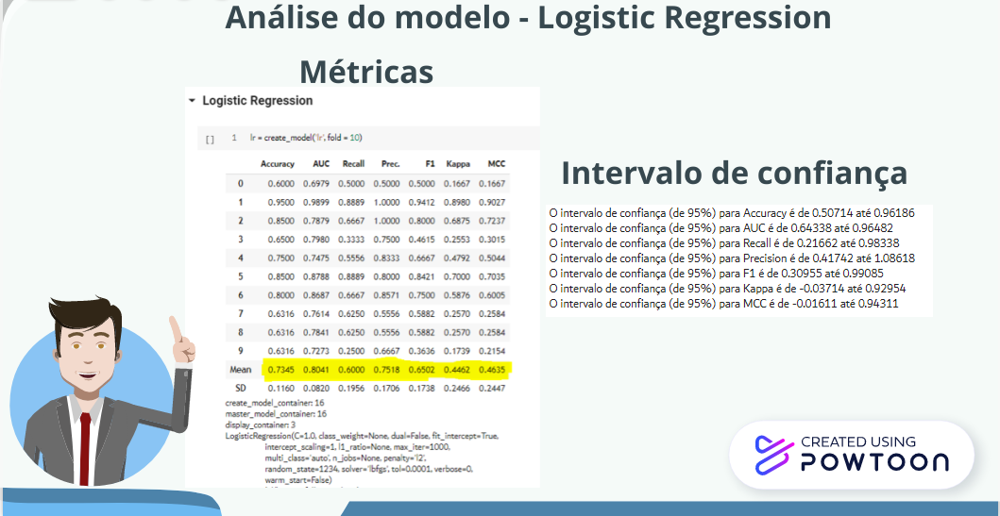

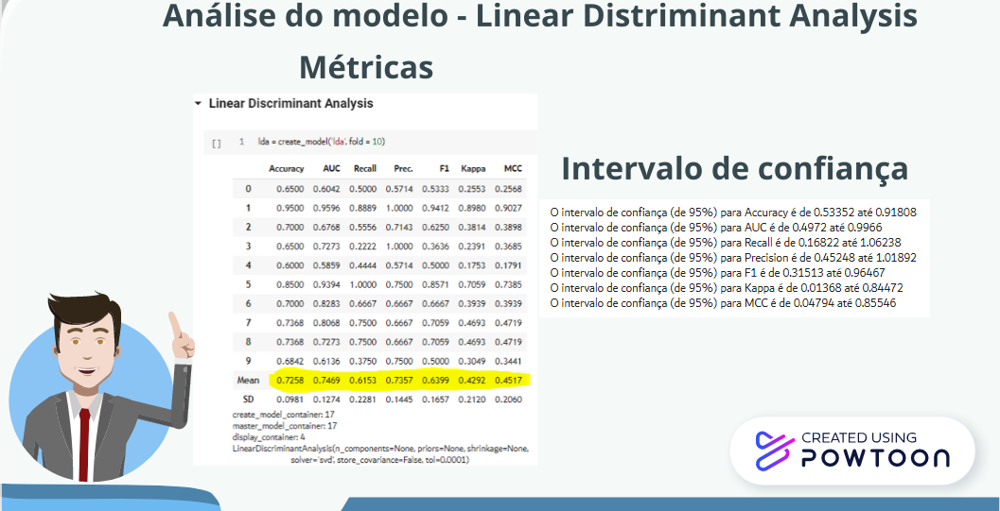

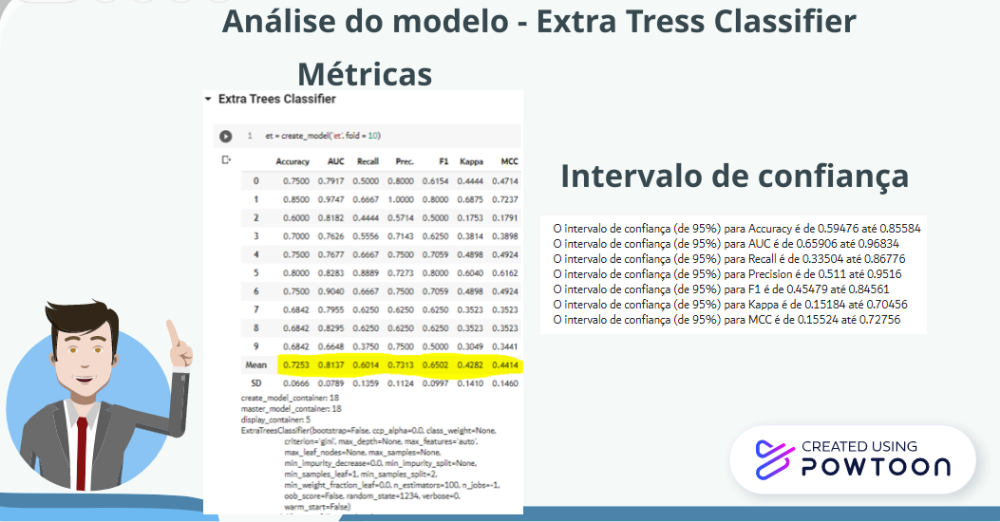

Apesar dessa comparação, os outros modelos previstos anteriormente se desempenhoram melhor.

## **4.10 Avaliando os modelos e selecionando o melhor**

A partir da seleção dos modelos, agora podemos analisar se os parâmetros estão coerentes com o previsto.

A função plot_model () pode ser usada para analisar o desempenho em diferentes aspectos, como AUC, confusão_matrix, limite de decisão, etc. Esta função pega um objeto de modelo treinado e retorna um gráfico baseado no teste / validação conjunto.

**Primeiramente, precisamos listar nosso objetivo:**

- Objetivamos o modelo que tem um alto AUC, para que assim seja capaz de distinguir as classes

- A classe de FN (Falsos negativos) deve ser a mais baixa possível, pois podemos encontrar um ponto crítico em nosso modelo: se a acurácia/auc for considerável em relação à outro modelo, podemos olhar a quantidade de FN's que o modelo está tendo. Caso o FN for alto, então o modelo está prevendo que a mais pessoas que precisavam de UTI não precisam. Veja a imagem a seguir:

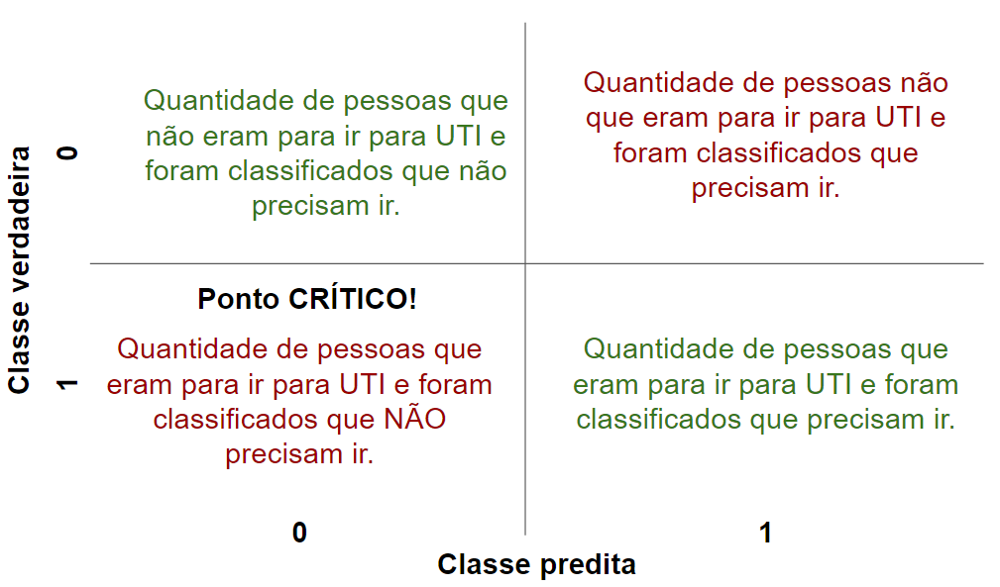

### **4.10.1 AUC**

Para determinar o modelo, foi considerada como principal métrica de avaliação a curva ROC AUC. De modo geral, ela explica melhor a acurácia, demonstrando se o modelo está sendo capaz de "separar" as duas catergorias, dito que tratamos de um modelo binário:

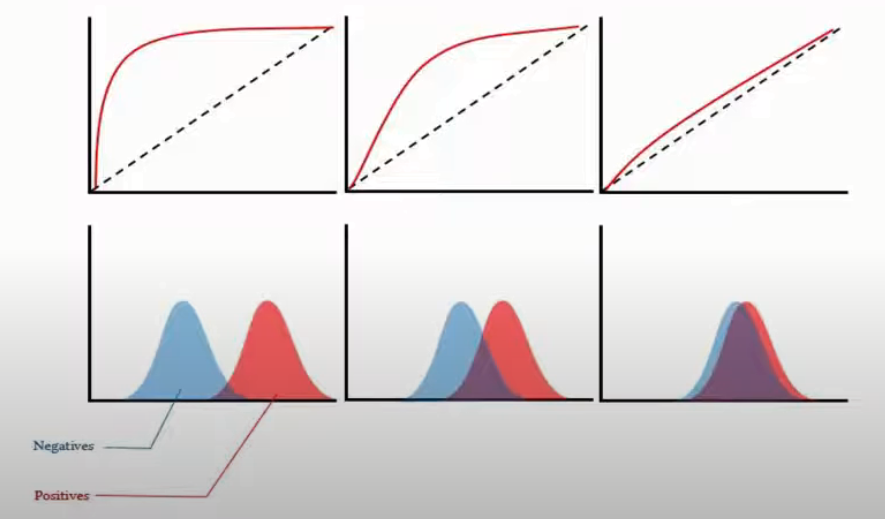

**Random Forest Classifier**

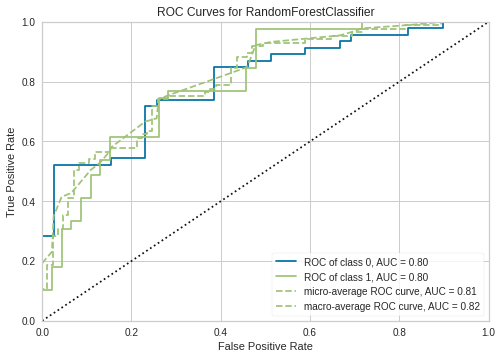

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf, plot = 'auc')

Essa curva apresenta uma média de 0,80 de AUC e apresenta uma suavidade maior

**Gradient Boosting Classifier**

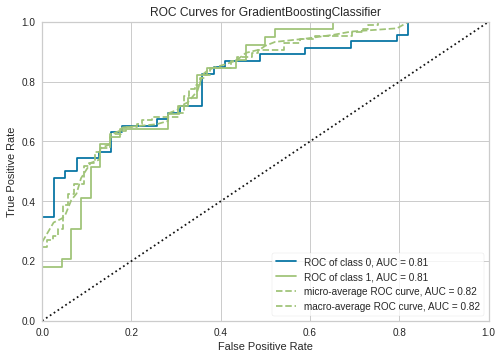

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_gbc, plot = 'auc')

Apesar de se apresentar maior o AUC, é visível algumas perturbações na curva.

**Extra Tress Classifier**

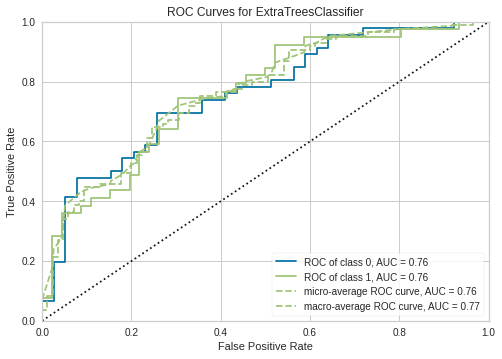

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, plot = 'auc')

Em seguida do gráfico anterior, este também apresentou mais perturbações em comparação com o Random Forest Classifier, e também apresentou o AUC mais baixo.

### **4.10.2 Feature importance**

O feature importance verifica quais são as variáveis mais importantes de cada modelo. Veremos a seguir quais são as mais influentes em cada um:

**Random Forest Classifier**

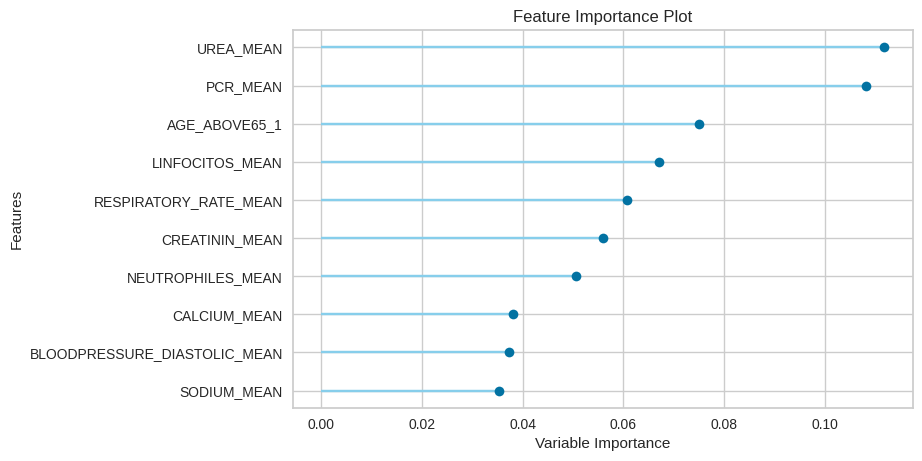

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf, plot='feature')

A variável mais importante é a "UREA_MEAN", em seguida da coluna "PCR_MEAN".

**Gradient Boosting Classifier**

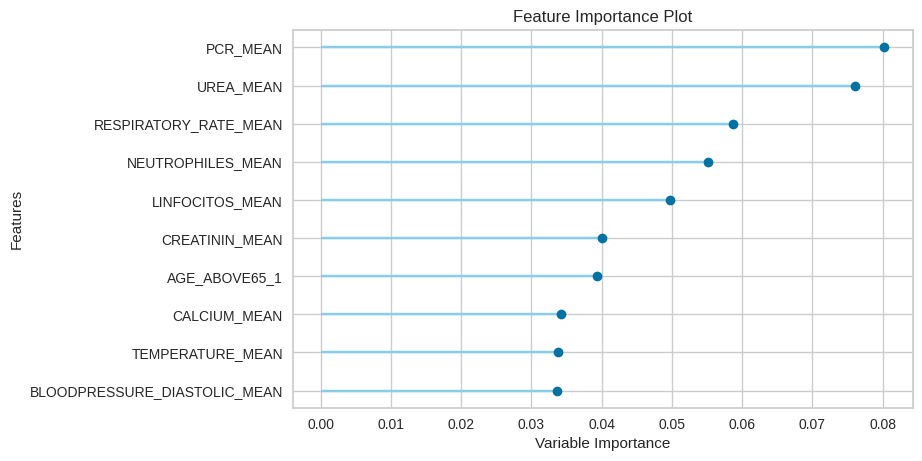

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_gbc, plot='feature')

Em paralelo com o modelo anterior, em referência das variáveis mais importantes, ocorre o contrário.

**Extra Tress Classifier**

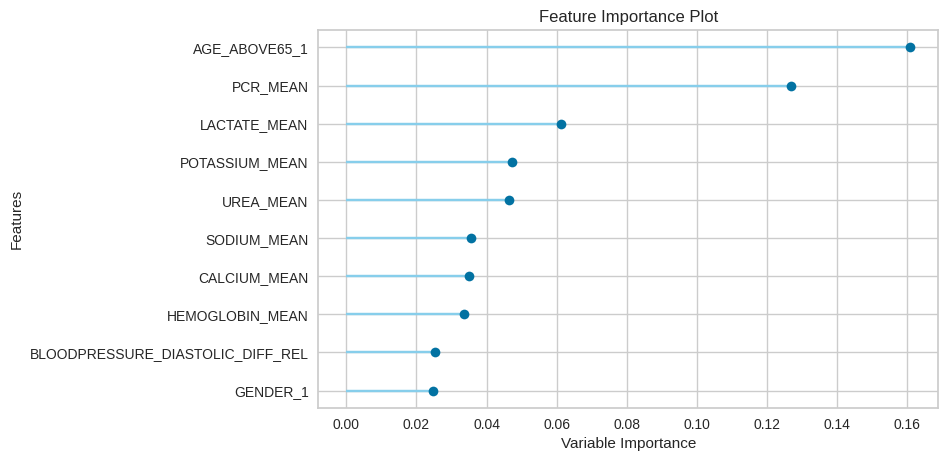

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, plot='feature')

Neste modelo, a variável mais importante é se o paciente possui mais de 65 anos. De acordo com as análises vistas na seção "Análise dos dados", é visível que quase metade dos dados possuem "AGE_ABOVE65". É um modelo que prioriza uma informação "não muito precisa".

### **4.10.3 Curva de Precisão-Recall**

Nesta análise, priorizamos um gráfico com este desempenho:

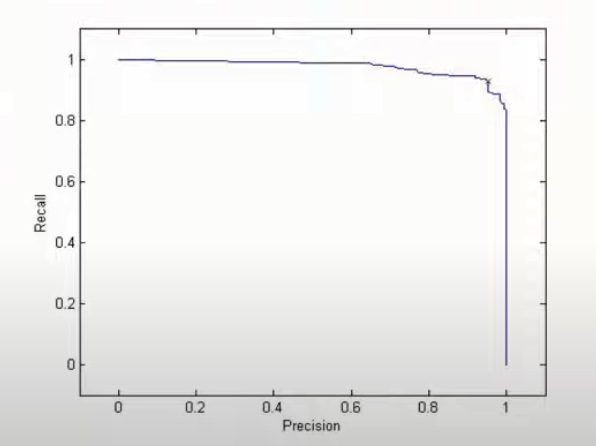

**Random Forest Classifier**

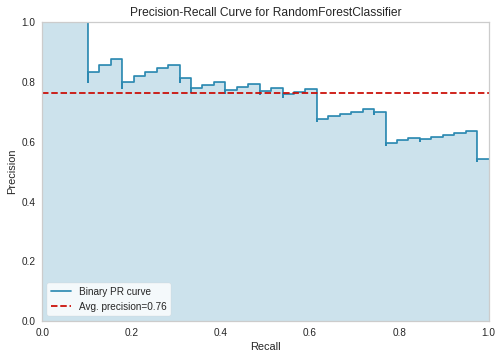

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf, plot = 'pr')

Com baixa variância, o modelo apresentou a média de 0,76

**Gradient Boosting Classifier**

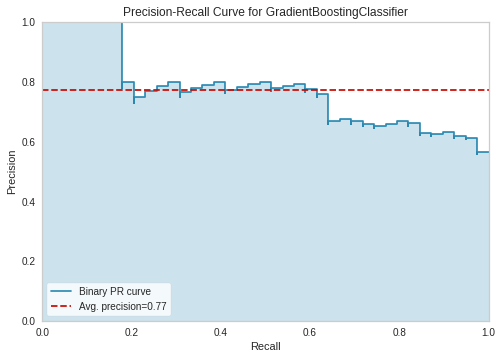

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_gbc, plot = 'pr')

Com alta variância, o modelo apresentou a média de 0,77

**Extra Tress Classifier**

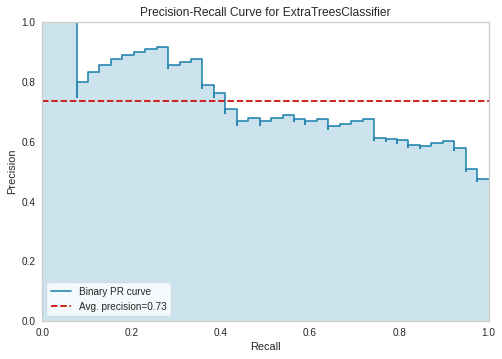

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, plot = 'pr')

Com alta variância, o modelo apresentou a média de 0,73

### **4.10.4 Matriz de confusão**

Baseado na premissa dita no início dessa seção, devemos priorizar sempre o menor FN:

**Random Forest Classifier**

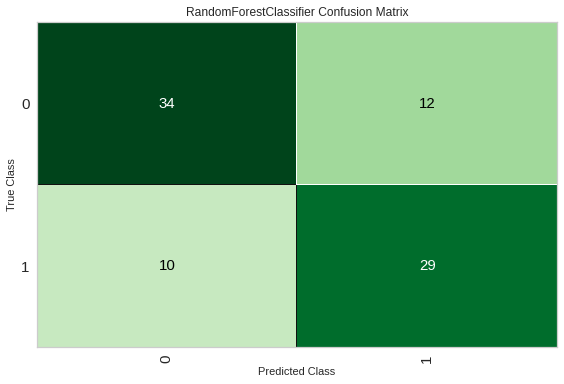

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf, plot='confusion_matrix')

O modelo apresentou apenas 10 FN, isto é: dos pacientes que precisavam ir para UTI  ele acertou 74,36% das vezes.

**Gradient Boosting Classifier**

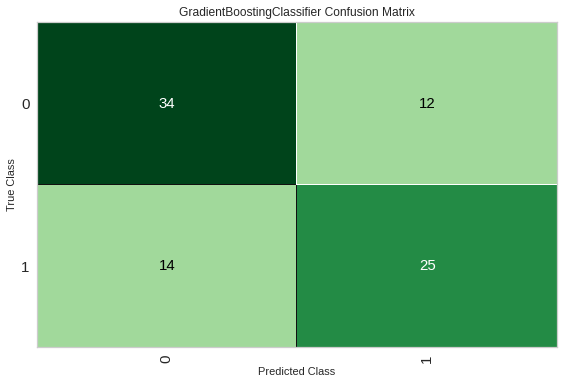

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_gbc, plot='confusion_matrix')

O modelo apresentou apenas 14 FN, isto é: dos pacientes que precisavam ir para UTI  ele acertou 64,10% das vezes.

**Extra Tress Classifier**

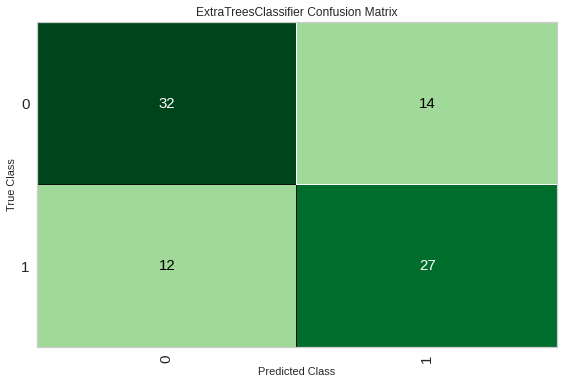

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, plot='confusion_matrix')

O modelo apresentou apenas 12 FN, isto é: dos pacientes que precisavam ir para UTI ele acertou 69,23% das vezes.

### **4.10.5 Reporte de classificação**

Nesta ocasião, iremos priorizar o modelo que atende os resultados "mais altos".

**Random Forest Classifier**

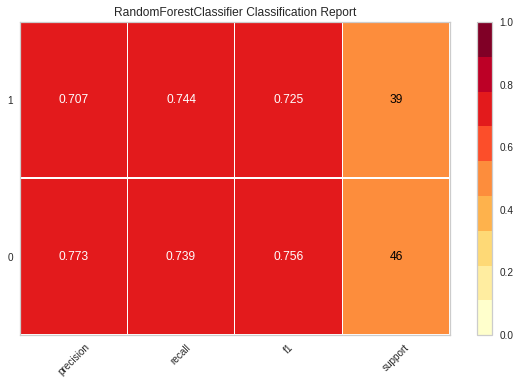

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_rf, plot='class_report')

**Gradient Boosting Classifier**

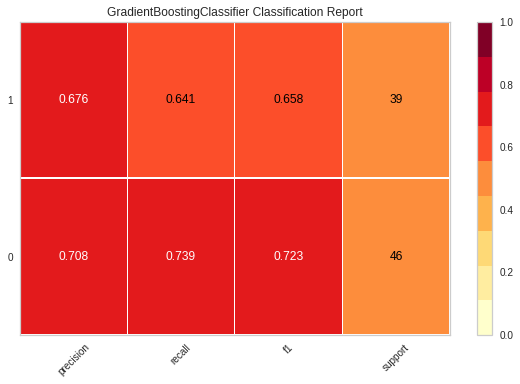

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_gbc, plot='class_report')

**Extra Tress Classifier**

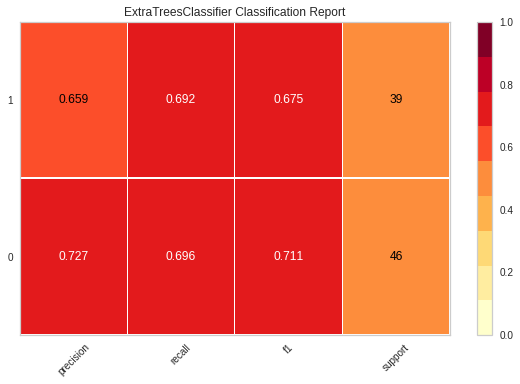

Visual Rendered Successfully
plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_et, plot='class_report')

**Conclusão**

De modo geral, é visível que o modelo **Random Forest Classifier** é o que se desempenhou melhor em **todas** as características.

### **4.10.6 Seleção do modelo**

Diante de todas as análises, de todos os intervalos de confiança e das métricas, em minha escolha promovo a seleção do modelo **Random Forest Classifier** pelos motivos:

- O modelo apresentou uma AUC alta e não muito diferente dos outros modelos. 
- Apresentou baixa variância nas métricas
- Intervalos de confiança mensuráveis e justos para as análises
- Precisão-Recall similar à desejada
- Features importantes de acordo com os exames de alta precisão
- Entre os pacientes que PRECISAM ir para UTI é o que mais acerta: em aproximadamente 75% dos casos.


**Quais são os hiperparâmetros do modelo?**

In [ ]:
#A seguir serão expostos cada parâmetro do modelo
plot_model(tuned_rf, 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,7
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.005
min_impurity_split,None


Visual Rendered Successfully
plot_model() succesfully completed......................................


De modo geral, podemos montar o modelo (pelo código), da seguinte forma:

In [ ]:
print(tuned_rf)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False)


Podemos também interpretar como cada variável está afetando, e também em qual classe a mesma afeta:

Initializing interpret_model()
interpret_model(use_train_data=False, estimator=RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False), save=False, plot=summary, observation=None, kwargs={}, feature=None)
Checking exceptions
plot type: summary
Creating TreeExplainer
Compiling shap values


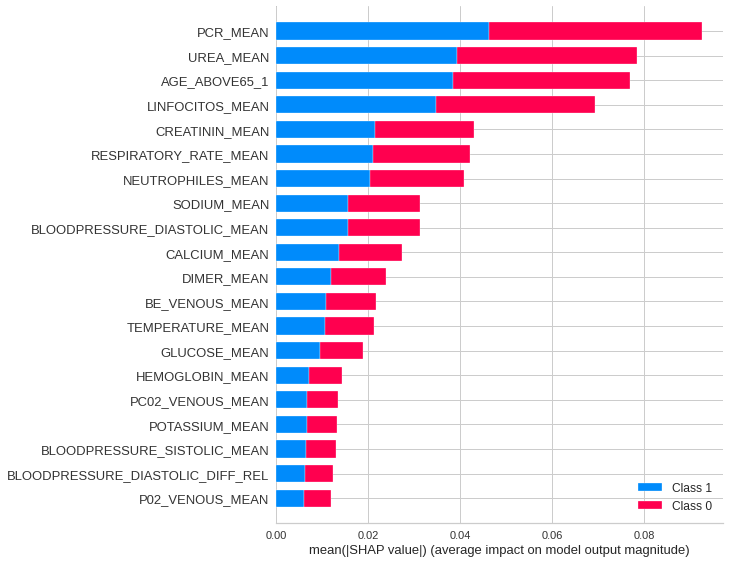

Visual Rendered Successfully
interpret_model() succesfully completed......................................


In [ ]:
interpret_model(tuned_rf)

É visível que, para as duas variáveis a feature "PCR_MEAN" é a que mais afeta. Vale salientar que é importante, também, identificar se o paciente é grupo de risco, isto é, com idade maior que 65 anos, identificado pela coluna "AGE_ABOVE65_1".
<br>
<br>
Essa informação pode ser extraída do próprio site do Governo Federal: https://coronavirus.saude.mg.gov.br/blog/84-grupos-de-risco-para-covid-19

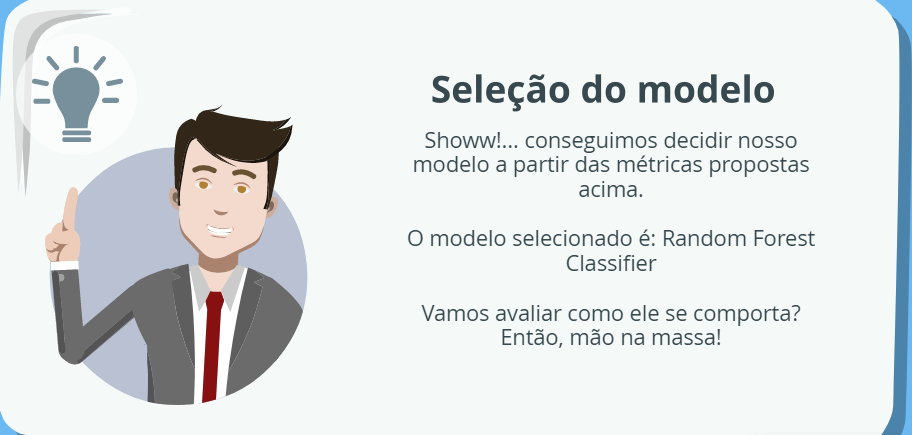

# **5. Conclusão e Predições com o modelo**

É necessária uma análise mais minuciosa em relação ao modelo, portanto, antes de finalizar o modelo, é aconselhável realizar uma verificação final, prevendo o conjunto de teste / retenção e revisando as métricas de avaliação.  Todas as métricas de avaliação que vimos acima são resultados de validação cruzada com base no conjunto de treinamento (70%) apenas. Agora, usando nosso modelo final treinado armazenado na variável tuned_rf, faremos uma previsão em relação à amostra de validação e avaliaremos as métricas para ver se elas são materialmente diferentes dos resultados do CV.

In [ ]:
predict_model(tuned_rf);

Initializing predict_model()
predict_model(display=None, ml_usecase=MLUsecase.CLASSIFICATION, verbose=True, round=4, raw_score=False, encoded_labels=False, probability_threshold=None, estimator=RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False))
Checking exceptions
Preloading libraries
Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.7412,0.8021,0.7436,0.7073,0.725,0.4808,0.4814


De modo geral, a precisão no conjunto de teste é bem próxima em comparação com resultado anterior do tuned_rf.  Se houver uma grande variação entre os resultados do teste, isso normalmente indicaria um sobreajuste, mas também poderia ser devido a vários outros fatores e exigiria uma investigação mais aprofundada. Neste caso, avançaremos com a finalização do modelo e a previsão de dados não vistos.

<br>

O objetivo da função finalize_model() é treinar o modelo no conjunto de dados completo antes de ser implantado na produção.

De fato, o AUC, a Acurácia e todos os outros valores estão de acordo com os parâmetros predeterminados anteriormente, e prezam pelo intervalo de confiança avaliado.

In [ ]:
final_rf = finalize_model(tuned_rf);

Initializing finalize_model()
finalize_model(display=None, model_only=True, groups=None, fit_kwargs=None, estimator=RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False))
Finalizing RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impur

## **5.1 Pipeline do modelo**

A partir do momento, terminamos o experimento finalizando o modelo tuned_rf que agora está armazenado na variável final_rf. Podemos salvá-lo e visualizar o pipeline da seguinte forma:

In [ ]:
save_model(final_rf, 'Model Final Random Forest Classifier')

Initializing save_model()
save_model(verbose=True, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='ICU',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strategy...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluster_all', 'passthrough'),
                ('dummy', D

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='ICU',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strategy...
                  RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                                         class_weight='balanced_subsample',
                                         criterion='gini', max_depth=7,
                                         max_features

Para carregar um modelo salvo em uma data futura no mesmo ambiente ou em um ambiente alternativo, usaríamos a função load_model () do PyCaret e então aplicaríamos facilmente o modelo salvo em novos dados não vistos para previsão.

In [ ]:
modelo_rf_salvo = load_model('Model Final Random Forest Classifier')

Initializing load_model()
load_model(verbose=True, authentication=None, platform=None, model_name=Model Final Random Forest Classifier)


Transformation Pipeline and Model Successfully Loaded


Podemos agora validar o nosso modelo:

In [ ]:
new_predictions = predict_model(modelo_rf_salvo, data=validation[:50]) #prevendo com 50 dados que o modelo ainda não conhece

Initializing predict_model()
predict_model(display=None, ml_usecase=MLUsecase.CLASSIFICATION, verbose=True, round=4, raw_score=False, encoded_labels=False, probability_threshold=None, estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='ICU',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strategy...
                 RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                     

In [ ]:
new_predictions.head()

,AGE_ABOVE65,GENDER,DISEASE GROUPING 1,DISEASE GROUPING 2,DISEASE GROUPING 3,DISEASE GROUPING 4,DISEASE GROUPING 5,DISEASE GROUPING 6,HTN,IMMUNOCOMPROMISED,OTHER,ALBUMIN_MEAN,BE_ARTERIAL_MEAN,BE_VENOUS_MEAN,BIC_ARTERIAL_MEAN,BIC_VENOUS_MEAN,BILLIRUBIN_MEAN,BLAST_MEAN,CALCIUM_MEAN,CREATININ_MEAN,FFA_MEAN,GGT_MEAN,GLUCOSE_MEAN,HEMOGLOBIN_MEAN,INR_MEAN,LACTATE_MEAN,LINFOCITOS_MEAN,NEUTROPHILES_MEAN,P02_ARTERIAL_MEAN,P02_VENOUS_MEAN,PC02_ARTERIAL_MEAN,PC02_VENOUS_MEAN,PCR_MEAN,PH_ARTERIAL_MEAN,PH_VENOUS_MEAN,PLATELETS_MEAN,POTASSIUM_MEAN,SAT02_ARTERIAL_MEAN,SODIUM_MEAN,TGO_MEAN,TGP_MEAN,TTPA_MEAN,UREA_MEAN,DIMER_MEAN,BLOODPRESSURE_DIASTOLIC_MEAN,BLOODPRESSURE_SISTOLIC_MEAN,HEART_RATE_MEAN,RESPIRATORY_RATE_MEAN,TEMPERATURE_MEAN,OXYGEN_SATURATION_MEAN,BLOODPRESSURE_DIASTOLIC_DIFF_REL,BLOODPRESSURE_SISTOLIC_DIFF_REL,HEART_RATE_DIFF_REL,RESPIRATORY_RATE_DIFF_REL,TEMPERATURE_DIFF_REL,OXYGEN_SATURATION_DIFF_REL,ICU,Label,Score
PATIENT_VISIT_IDENTIFIER,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
50,1,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-0.308901,-0.317073,-0.073171,-0.938950,-1.0,0.000000,-0.933475,-0.742004,-0.958528,-0.891993,-0.060976,-0.959849,-0.897773,-0.738589,-0.614646,-0.170732,0.017751,-0.77931,-0.779141,-0.887335,0.234043,0.666667,-0.484646,-0.555556,0.939394,-0.257143,-0.996454,-0.995808,-0.846633,-0.720482,-0.976101,0.358025,-0.076923,0.169811,-0.254237,0.089286,0.789474,-1.000000,-1.000000,-1.000000,-1.0,-0.929255,-1.000000,0,1,0.6983
8,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.081633,-0.868365,-0.742004,-0.990654,-0.891993,-0.012195,-0.959849,-0.952572,-0.724066,-0.851140,-0.170732,-0.704142,-0.77931,-0.754601,-0.798110,0.234043,0.363636,-0.522029,-0.777778,0.939394,-0.600000,-0.998134,-0.997332,-0.846633,-0.874699,-0.978029,-0.185185,-0.630769,-0.320755,-0.593220,0.464286,0.789474,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0,0,0.6339
277,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.357143,-0.885350,-0.742004,-0.958528,-0.873371,-0.012195,-0.959849,1.000000,-0.819502,-0.939576,-0.170732,-0.704142,-0.77931,-0.754601,-0.941021,0.234043,0.363636,-0.676903,-0.518519,0.939394,0.142857,-0.995521,-0.984375,-0.846633,-0.884337,-1.000000,0.308642,-0.076923,-0.264151,-0.525424,0.250000,0.894737,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0,0,0.7911
244,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.605263,-1.0,-1.000000,-0.317073,-0.317073,-0.938950,-1.0,0.204082,-0.881104,-0.742004,-0.958528,-0.891993,-0.341463,-0.959849,1.000000,-0.838174,-0.873950,-0.170732,-0.704142,-0.77931,-0.754601,-0.774669,0.234043,0.363636,-0.538051,-0.481481,0.939394,0.066667,-0.996081,-0.996189,-0.846633,-0.879518,-0.977335,-0.012346,-0.292308,-0.283019,-0.457627,0.142857,0.842105,-1.000000,-1.000000,-1.000000,-1.0,-1.000000,-1.000000,0,1,0.5060
100,1,1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.315789,-1.0,-1.000000,-0.317073,-0.365854,-0.989534,-1.0,0.306122,-0.780609,-0.820896,-0.954439,-0.891993,-0.548780,-0.957340,-0.886215,-0.856846,-0.965186,-0.170732,-0.893491,-0.77931,-0.717791,-0.947070,0.234043,0.181818,-0.634179,-0.666667,0.939394,0.066667,-0.988989,-0.981326,-0.798365,-0.802410,-0.989053,-0.629630,-0.553846,-0.811321,-0.525424,-0.107143,0.684211,-0.959079,-0.971184,-0.895824,-1.0,-0.808466,-0.959202,1,1,0.6784


In [ ]:
metricas = ['Accuracy',	'AUC',	'Recall',	'Precision',	'F1',	'Kappa',	'MCC']

for x in metricas:
  print(f'A métrica {x} é {check_metric(new_predictions.ICU, new_predictions.Label, x)}')

A métrica Accuracy é 0.72
A métrica AUC é 0.7214
A métrica Recall é 0.7391
A métrica Precision é 0.68
A métrica F1 é 0.7083
A métrica Kappa é 0.44
A métrica MCC é 0.4414


De fato, as métricas estão dentro do intervalo de confiança proposto! Também é possível verificar quantos pacientes que deveriam ir para UTI e ele classificou como verdadeiro:

In [ ]:
tn, fp, fn, tp = confusion_matrix(new_predictions['ICU'], new_predictions['Label']).ravel()
(tn, fp, fn, tp)

(19, 8, 6, 17)

In [ ]:
print(f'Dos pacientes que precisavam ir para UTI em {round(100 - (fn/(tp+fn)*100), 2)}% dos casos foram acertados.') #calculo do Recall

Dos pacientes que precisavam ir para UTI em 73.91% dos casos foram acertados.


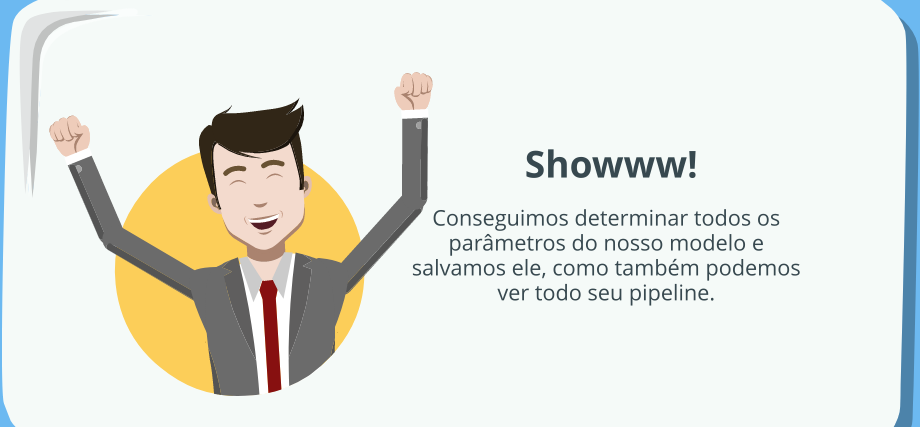

Nosso modelo está trabalhando com eficiência e está disposto a trabalhar frente às métricas expostas acima. O modelo selecionado foi: Random Forest Classifier.

Os hiperparâmetros são:

```
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.005,
                       min_impurity_split=None, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=160, n_jobs=-1, oob_score=False,
                       random_state=1405, verbose=0, warm_start=False)

```


### **Resumo geral das métricas**

> No conjunto de dados novos (50 dados testados acima)

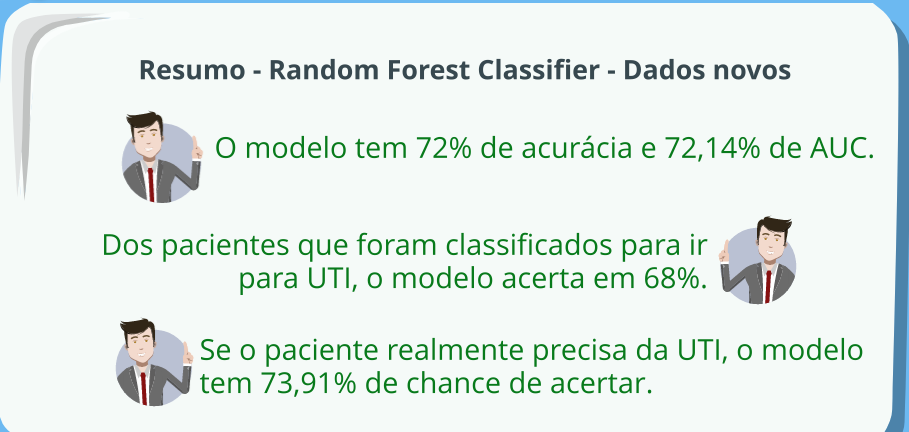

> No conjunto de dados de teste (testados para avaliar as métricas do modelo)

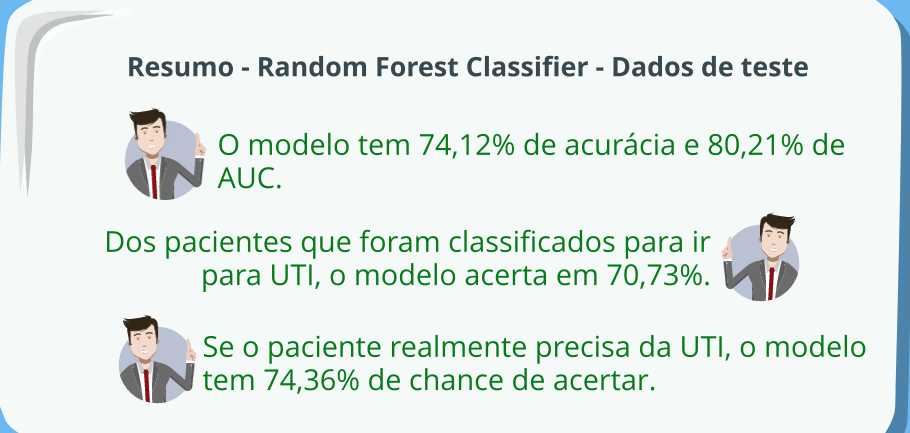

# **Testes de hipóteses para as métricas do modelo**

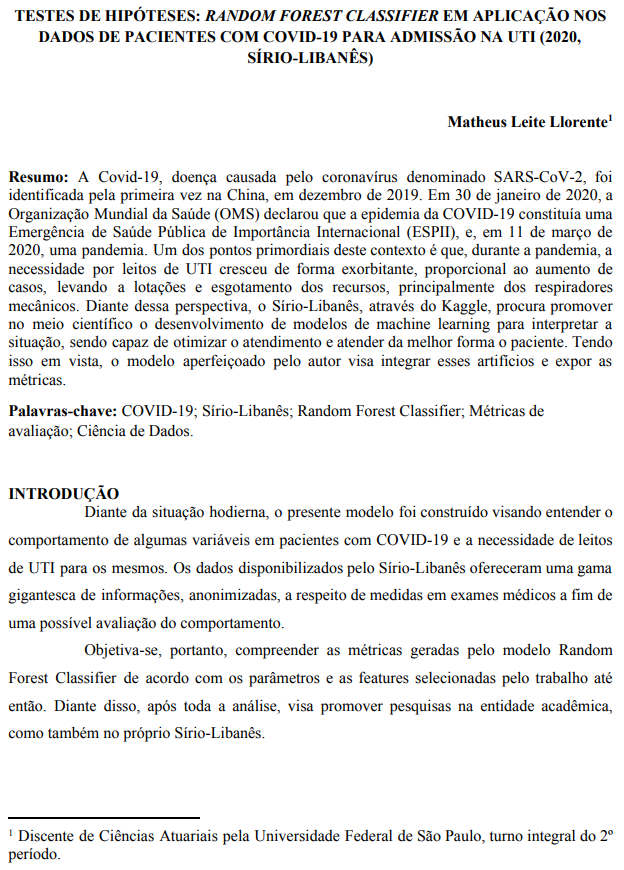

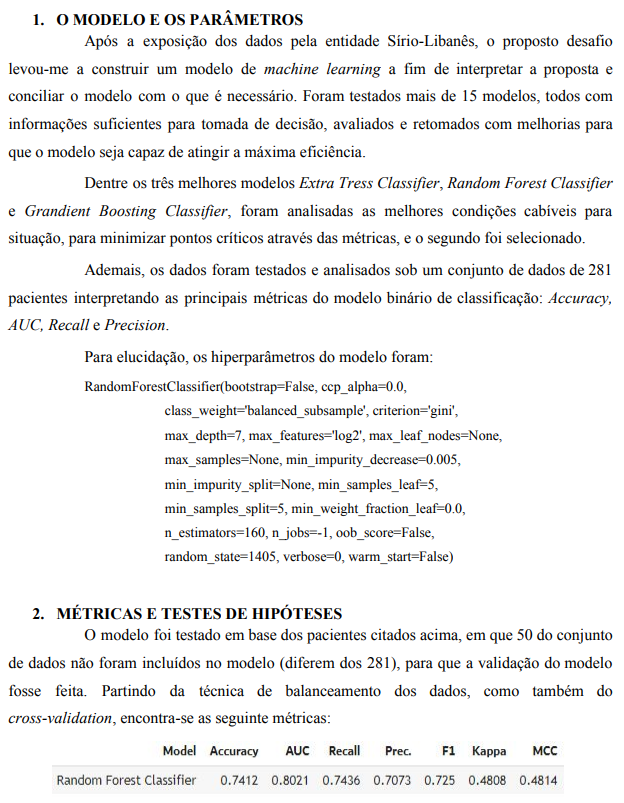

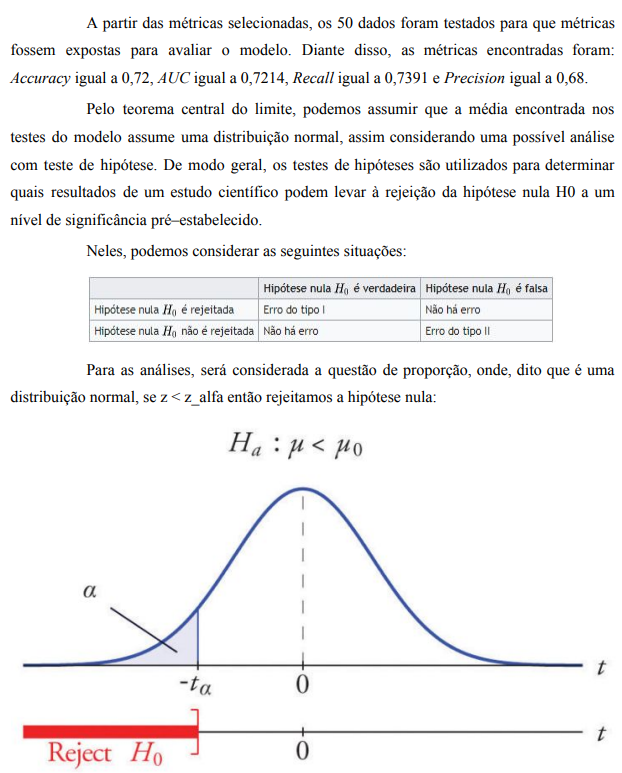

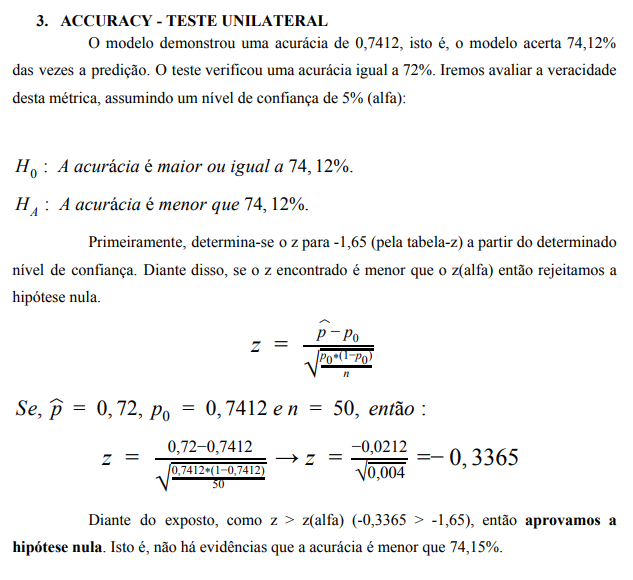

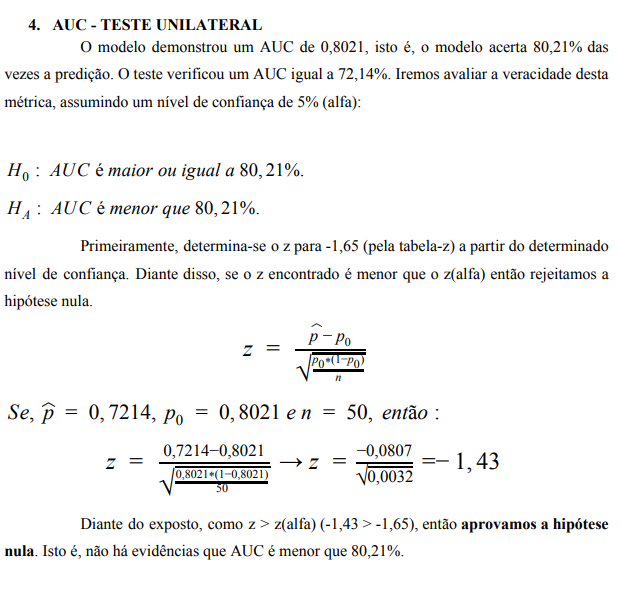

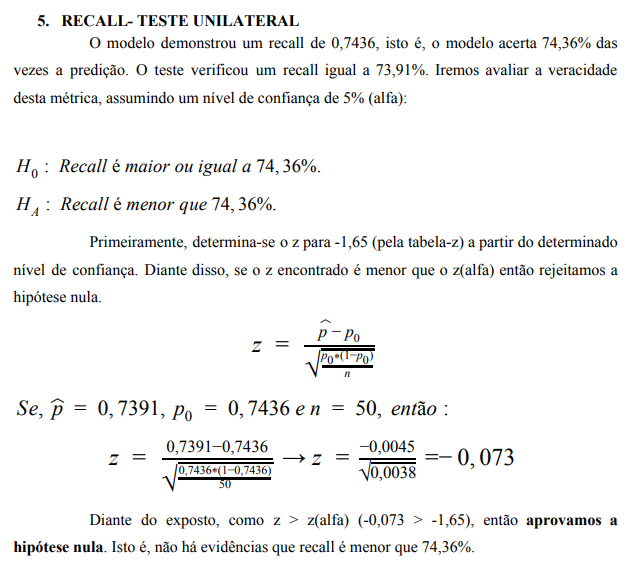

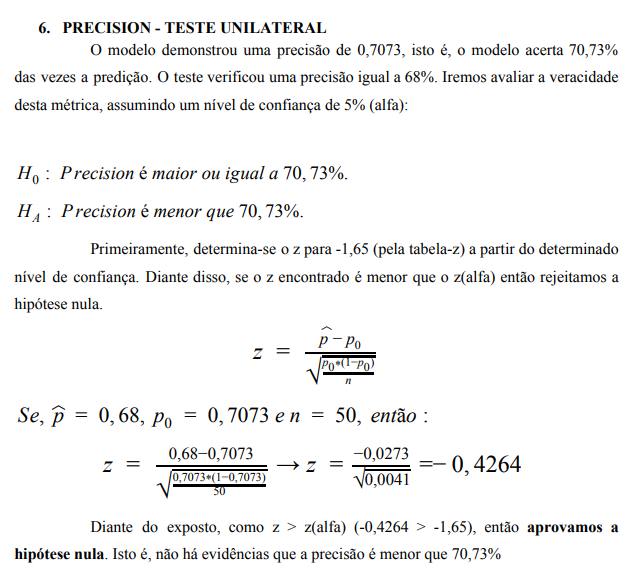

# **Referências**

> **COVID-19: quais são os critérios para internação em uma UTI?:** Sintomas mais graves da doença levam à necessidade de ventilação mecânica invasiva. Sintomas mais graves da doença levam à necessidade de ventilação mecânica invasiva. 2020. Disponível em: https://summitsaude.estadao.com.br/novos-medicos/covid-19-quais-sao-os-criterios-para-internacao-em-uma-uti/. Acesso em: 22 fev. 2021.

> KUNUMI. **Métricas de Avaliação em Machine Learning: Classificação**. Disponível em: https://medium.com/kunumi/m%C3%A9tricas-de-avalia%C3%A7%C3%A3o-em-machine-learning-classifica%C3%A7%C3%A3o-49340dcdb198. Acesso em: 20 fev. 2021.

> **MACHINE Learning**. Disponível em: https://en.wikipedia.org/wiki/Machine_learning. Acesso em: 20 fev. 2021.

> Mann, Prem S. “**Introdução à Estatística**”. LTC, 8ª edição, 12 de abril de 2015, 788 p.: http://amzn.to/2fSJwcG

> OLIVEIRA, Wanderson Kleber de et al . **Como o Brasil pode deter a COVID-19** Epidemiol. Serv. Saúde,  Brasília ,  v. 29, n. 2,  e2020044,  maio  2020 .   Disponível em <http://scielo.iec.gov.br/scielo.php?script=sci_arttext&pid=S1679-49742020000200002&lng=pt&nrm=iso>. acessos em  22  fev.  2021.  Epub 24-Abr-2020.  http://dx.doi.org/10.5123/s1679-49742020000200023.

>  PYCARET. **Machine Learning:** classification. Classification. Disponível em: https://pycaret.org/classification/. Acesso em: 19 fev. 2021.

> RODRIGUES, Vitor. **Métricas de Avaliação: acurácia, precisão, recall… quais as diferenças?** Disponível em: https://medium.com/@vitorborbarodrigues/m%C3%A9tricas-de-avalia%C3%A7%C3%A3o-acur%C3%A1cia-precis%C3%A3o-recall-quais-as-diferen%C3%A7as-c8f05e0a513c. Acesso em: 20 fev. 2021.

> SANTI, Daniel B. Dei. **Conforto respiratório: UTI é o melhor lugar para todos os pacientes com COVID-19?** 2020. Disponível em: https://socesp.org.br/publico/cuidados-paliativos/videos-e-artigos/conforto-respiratorio-uti-e-o-melhor-lugar-para-todos-os-pacientes-com-covid-19/. Acesso em: 22 fev. 2021.

> SANTOS, Hellen Geremias dos et al. **Machine learning para análises preditivas em saúde:** exemplo de aplicação para predizer óbito em idosos de São Paulo, Brasil. Cadernos de Saúde Pública, v. 35, p. e00050818, 2019.

> SÍRIO-LIBANÊS.**Conjunto de dados.** Disponível em: https://www.kaggle.com/S%C3%ADrio-Libanes/covid19. Acesso em: 22 fev. 2021.

**Agradecimento**
<br>
Obrigado a todos que acompanharam essa jornada. Foi de grande valia a experiência em uma oportunidade bela para minha carreira. Fico lisonjeado em compartilhar o espaço(virtual)-tempo com vocês: todo time da alura (Thiago, Guilherme, Allan, Karoline, Diogo, todo scuba team (Victor, Igor...), Paulo... entre várias pessoas incríveis!), todos os colegas do discord, o Átila, o suporte profissional da revelo (Patrícia) e da Nubank (Moneda...)! :)
<br>
<br>
Abs,
<br>
Matheus.
